# Compare the v4.2 recalibrated SDSS Stripe82 catalog 
# and Pan-STARRS1 catalog

### use the SDSS g-i color and linear interpolation for bandpass transformations 

[Link to helper tools](#dataTools) 

[Link to data reading](#dataReading) 

[Link to data analysis](#dataAnalysis) 

In [1]:
%matplotlib inline
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astropy import units as u
from astropy.table import hstack
import matplotlib.pyplot as plt 
import numpy as np
from astroML.plotting import hist
# for astroML installation see https://www.astroml.org/user_guide/installation.html

In [2]:
## automatically reload any modules read below that might have changed (e.g. plots)
%load_ext autoreload
%autoreload 2
# importing ZI tools: 
import ZItools as zit
# importing Karun's tools: 
import KTtools as ktt

<a id='dataTools'></a>

### Helper Tools

In [3]:
# robust standard deviation
def sigG(arr):
    return 0.741*(np.quantile(arr, 0.75)-np.quantile(arr, 0.25))

In [4]:
### code for generating new quantities, such as dra, ddec, colors, differences in mags, etc
def derivedColumns(matches, newFlag=1):
    matches['ra'] = matches['ra_new']
    matches['dec'] = matches['dec_new']
    matches['dra'] = (matches['ra']-matches['raPS'])*3600
    matches['ddec'] = (matches['dec']-matches['decPS'])*3600
    ra = matches['ra'] 
    matches['raW'] = np.where(ra > 180, ra-360, ra) 
    if (newFlag):
        # matches['u_mMed'] = matches['u_mMed_new']
        matches['g_mMed'] = matches['g_mMed_new']
        matches['r_mMed'] = matches['r_mMed_new']
        matches['i_mMed'] = matches['i_mMed_new']
        matches['z_mMed'] = matches['z_mMed_new']
    matches['dg'] = matches['g_mMed'] - matches['gPS'] 
    matches['dr'] = matches['r_mMed'] - matches['rPS'] 
    matches['di'] = matches['i_mMed'] - matches['iPS'] 
    matches['dz'] = matches['z_mMed'] - matches['zPS'] 
    matches['gr'] = matches['g_mMed'] - matches['r_mMed']
    matches['ri'] = matches['r_mMed'] - matches['i_mMed']
    matches['gi'] = matches['g_mMed'] - matches['i_mMed']
    matches['iz'] = matches['i_mMed'] - matches['z_mMed']
    matches['rz'] = matches['r_mMed'] - matches['z_mMed']
    matches['dgr'] = matches['dg'] - matches['dr'] 
    matches['dri'] = matches['dr'] - matches['di'] 
    matches['diz'] = matches['di'] - matches['dz'] 
    matches['drz'] = matches['dr'] - matches['dz'] 
    matches['dgi'] = matches['dg'] - matches['di'] 
    return

In [5]:
def doOneColor(d, kw):
    print('=========== WORKING ON:', kw['Ystr'], '===================')
    xVec = d[kw['Xstr']]
    yVec = d[kw['Ystr']]
    # 
    # this is where the useable range of color specified by Xstr is defined
    # it's really a hack - these limits should be passed via kw... 
    xMin = 0.5
    xMax = 3.1
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, xMin, xMax, 52, 0)
    fig,ax = plt.subplots(1,1,figsize=(8,6))
    ax.scatter(xVec, yVec, s=0.01, c='blue')
    ax.scatter(xBin, medianBin, s=5.2, c='yellow')
    ax.set_xlim(0.4,3.2)
    ax.set_ylim(-0.5,0.5)
    ax.set_xlabel(kw['Xstr'])
    ax.set_ylabel(kw['Ystr'])
    # THERE IS NO ANALYTIC COLOR TERM: linear interpolation of the binned medians! 
    d['colorfit'] = np.interp(xVec, xBin, medianBin)
    # the following line corrects the trend given by the binned medians 
    d['colorresid'] = d[kw['Ystr']] - d['colorfit'] 
    # note that we only use the restricted range of color for ZP analysis
    # 0.3 mag limit is to reject gross outliers
    goodC = d[(np.abs(d['colorresid'])<0.3)&(xVec>xMin)&(xVec<xMax)]
    
    ### plots 
    # RA
    print(' stats for RA binning medians:')
    plotNameRoot = kw['plotNameRoot'] + kw['Ystr']
    plotName = plotNameRoot + '_RA.png'
    Ylabel =kw['Ystr'] + ' residuals'
    kwOC = {"Xstr":'raW', "Xmin":-45, "Xmax":47, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-43, "XmaxBin":45, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    print('made plot', plotName)
    plotName = plotNameRoot + '_RA_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)  
    print('made plot', plotName)

    # Dec
    print('-----------')
    print(' stats for Dec binning medians:')
    plotName = plotNameRoot + '_Dec.png'
    kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    print('made plot', plotName)
    plotName = plotNameRoot + '_Dec_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)  
    print('made plot', plotName)


    # r SDSS
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_rmag.png'    
    kwOC = {"Xstr":'r_mMed', "Xmin":14.3, "Xmax":22.2, "Xlabel":'SDSS r (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    print('made plot', plotName)
    plotName = plotNameRoot + '_rmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)  
    print('made plot', plotName)
    print('------------------------------------------------------------------')
   

<a id='dataReading'></a>

### Define paths and catalogs 

In [6]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
# Karun's match of v3.2 and Pan-STARRS catalog (from Doug)
PScatalog = ZIdataDir + "/" + "nSSC2PS1_matched.csv" 
colnamesSDSSPS = ['ra', 'dec', 'nEpochs',   
                'g_Nobs', 'g_mMed', 'g_mErr', 
                'r_Nobs', 'r_mMed', 'r_mErr',  
                'i_Nobs', 'i_mMed', 'i_mErr',  
                'z_Nobs', 'z_mMed', 'z_mErr', 
                'raPS', 'decPS', 
                'gPS', 'gErrPS', 'gNobsPS',
                'rPS', 'rErrPS', 'rNobsPS',
                'iPS', 'iErrPS', 'iNobsPS',
                'zPS', 'zErrPS', 'zNobsPS']

In [7]:
sdssPSraw = Table.read(PScatalog, format='csv', names=colnamesSDSSPS) 
print(np.size(sdssPSraw))

943185


<a id='dataTools'></a>

### Overwrite SDSS catalog with a new one!

In [8]:
## read the latest and greatest SDSS catalog
colnamesSDSS = ['calib_fla', 'ra', 'dec', 'raRMS', 'decRMS', 'nEpochs', 'AR_val', 
                'u_Nobs', 'u_mMed', 'u_mMean', 'u_mErr', 'u_rms_scatt', 'u_chi2',
                'g_Nobs', 'g_mMed', 'g_mMean', 'g_mErr', 'g_rms_scatt', 'g_chi2',
                'r_Nobs', 'r_mMed', 'r_mMean', 'r_mErr', 'r_rms_scatt', 'r_chi2',
                'i_Nobs', 'i_mMed', 'i_mMean', 'i_mErr', 'i_rms_scatt', 'i_chi2',
                'z_Nobs', 'z_mMed', 'z_mMean', 'z_mErr', 'z_rms_scatt', 'z_chi2']

sdssNewCatIn = ZIdataDir + "/" + "stripe82calibStars_v4.2.dat"
# sdssNewCatIn = ZIdataDir + "/" + "stripe82calibStars_v3.1.dat"

readFormat = 'ascii'
sdssNew = Table.read(sdssNewCatIn, format=readFormat, names=colnamesSDSS)
np.size(sdssNew)

991472

In [9]:
## now match sdssPSraw to sdssNew 
sdssPS_coords = SkyCoord(ra = sdssPSraw['ra']*u.degree, dec= sdssPSraw['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssPS_coords)  
sdssPSnew = hstack([sdssNew, sdssPSraw[idx]], table_names = ['new', 'old'])
sdssPSnew['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdssPS = sdssPSnew[(sdssPSnew['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdssPS))
## and now overwrite all SDSS fields 

939319


In [10]:
sdssPS

calib_fla,ra_new,dec_new,raRMS,decRMS,nEpochs_new,AR_val,u_Nobs,u_mMed,u_mMean,u_mErr,u_rms_scatt,u_chi2,g_Nobs_new,g_mMed_new,g_mMean,g_mErr_new,g_rms_scatt,g_chi2,r_Nobs_new,r_mMed_new,r_mMean,r_mErr_new,r_rms_scatt,r_chi2,i_Nobs_new,i_mMed_new,i_mMean,i_mErr_new,i_rms_scatt,i_chi2,z_Nobs_new,z_mMed_new,z_mMean,z_mErr_new,z_rms_scatt,z_chi2,ra_old,dec_old,nEpochs_old,g_Nobs_old,g_mMed_old,g_mErr_old,r_Nobs_old,r_mMed_old,r_mErr_old,i_Nobs_old,i_mMed_old,i_mErr_old,z_Nobs_old,z_mMed_old,z_mErr_old,raPS,decPS,gPS,gErrPS,gNobsPS,rPS,rErrPS,rNobsPS,iPS,iErrPS,iNobsPS,zPS,zErrPS,zNobsPS,sep_2d_arcsec
str18,float64,float64,float64,float64,int64,float64,int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,int64,int64,float64,float64,int64,float64,float64,int64,float64,float64,int64,float64,float64,float64,float64,float64,float64,int64,float64,float64,int64,float64,float64,int64,float64,float64,int64,float64
CALIBSTARS_0000001,308.500219,-1.227713,0.0227,0.0227,7,0.587,3,23.87,23.823,0.611,0.06,0.056,6,22.388,22.269,0.05,0.154,1.554,7,20.832,20.834,0.017,0.056,1.05,7,20.168,20.202,0.015,0.046,1.105,7,19.9,19.818,0.04,0.116,1.212,308.500219,-1.2277129999999998,7,6,22.387,0.05,7,20.833,0.017,7,20.173,0.015,7,19.909,0.04,308.50020898,-1.2277108,21.7702,0.0592,5,20.8716,0.0192,14,20.2071,0.0219,19,19.8986,0.0238,11,7.156248033292913e-13
CALIBSTARS_0000002,308.500072,-1.240266,0.0141,0.0141,7,0.596,4,21.97,21.966,0.093,0.045,0.225,7,20.488,20.462,0.014,0.042,1.116,7,19.763,19.768,0.011,0.052,0.299,7,19.532,19.504,0.013,0.032,0.808,7,19.439,19.386,0.034,0.095,0.824,308.50007200000005,-1.240266,7,7,20.488,0.014,7,19.765,0.011,7,19.536,0.013,7,19.449,0.034,308.50005708,-1.24027407,20.3295,0.0231,10,19.742,0.0106,7,19.5214,0.022,13,19.347,0.0193,10,2.0458836545716636e-10
CALIBSTARS_0000003,308.500101,-1.217158,0.0154,0.0154,7,0.579,7,19.394,19.385,0.012,0.021,0.625,6,17.977,17.977,0.005,0.008,0.566,7,17.318,17.317,0.004,0.008,0.889,7,17.052,17.05,0.005,0.027,1.752,6,16.873,16.874,0.007,0.004,0.215,308.500101,-1.217158,7,6,17.976,0.005,7,17.32,0.004,7,17.055,0.005,6,16.882,0.007,308.50011183,-1.21714522,17.8869,0.0041,13,17.3202,0.0029,14,17.0472,0.0032,13,16.9327,0.003,11,0.0
CALIBSTARS_0000004,308.501912,-1.176494,0.0117,0.0117,7,0.559,7,20.605,20.598,0.028,0.081,0.852,6,18.457,18.459,0.006,0.007,0.428,7,17.549,17.556,0.005,0.022,0.797,6,17.198,17.188,0.006,0.007,0.496,7,16.968,16.966,0.009,0.022,0.653,308.501912,-1.1764940000000002,7,6,18.458,0.006,7,17.551,0.005,6,17.201,0.006,7,16.975,0.009,308.50192944,-1.17649183,18.316,0.0057,13,17.5354,0.0041,9,17.1794,0.0031,15,17.0113,0.003,4,1.431249606658583e-12
CALIBSTARS_0000005,308.504615,-1.174191,0.04,0.04,7,0.556,2,23.955,23.985,0.634,0.103,0.114,5,23.084,23.022,0.097,0.133,0.542,7,21.299,21.326,0.025,0.06,0.992,7,20.347,20.331,0.016,0.061,1.381,7,19.861,19.747,0.036,0.168,1.733,308.504615,-1.174191,7,5,23.084,0.097,7,21.301,0.025,7,20.351,0.016,7,19.868,0.036,308.50461085,-1.17418672,22.0866,0.1861,1,21.2575,0.0384,11,20.3523,0.0126,18,19.8721,0.05,9,0.0
CALIBSTARS_0000006,308.501254,-1.119302,0.0166,0.0166,8,0.537,3,22.436,22.454,0.275,0.123,0.126,7,20.103,20.099,0.013,0.008,0.118,8,19.141,19.127,0.007,0.022,0.561,7,18.765,18.763,0.009,0.01,0.146,8,18.515,18.505,0.015,0.016,0.403,308.501254,-1.119302,8,7,20.103,0.013,8,19.143,0.007,7,18.769,0.009,8,18.523,0.015,308.5012693,-1.11930436,19.9532,0.0167,14,19.1313,0.0085,12,18.7483,0.0098,18,18.5998,0.0146,9,0.0
CALIBSTARS_0000007,308.503096,-1.132302,0.0295,0.0295,8,0.543,6,19.335,19.332,0.012,0.009,0.257,7,17.81,17.807,0.005,0.008,0.689,8,17.158,17.161,0.004,0.012,0.962,7,16.907,16.91,0.004,0.005,0.334,8,16.757,16.755,0.006,0.012,0.673,308.50309599999997,-1.1323020000000001,8,7,17.811,0.005,8,17.159,0.004,7,16.911,0.004,8,16.765,0.006,308.50307797,-1.

In [11]:
derivedColumns(sdssPS)

In [12]:
sdssPSbright = sdssPS[sdssPS['r_mMed']<20]
print(np.size(sdssPS), np.size(sdssPSbright))

939319 545023


=========== WORKING ON: dg ===================
 stats for RA binning medians:
medianAll: -0.001860000000000167 std.dev.All: 0.03356729999999976
N= 805889 min= -0.29989999999999906 max= 0.29999999999999927
median: -0.0038640000000006863 std.dev: 0.003512201820708251
saved plot as: colorResidPS_dg_RA.png


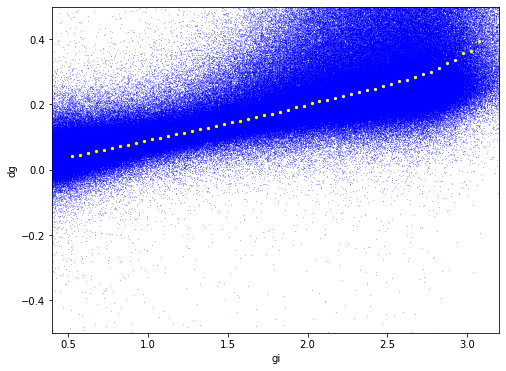

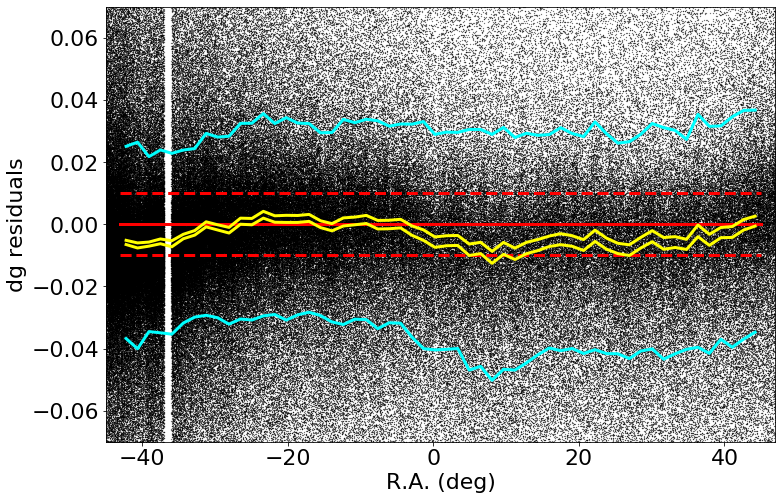

made plot colorResidPS_dg_RA.png
medianAll: -0.001860000000000167 std.dev.All: 0.03356729999999976
N= 805889 min= -0.29989999999999906 max= 0.29999999999999927
median: -0.004370000000000512 std.dev: 0.003503521015627453
saved plot as: colorResidPS_dg_RA_Hess.png


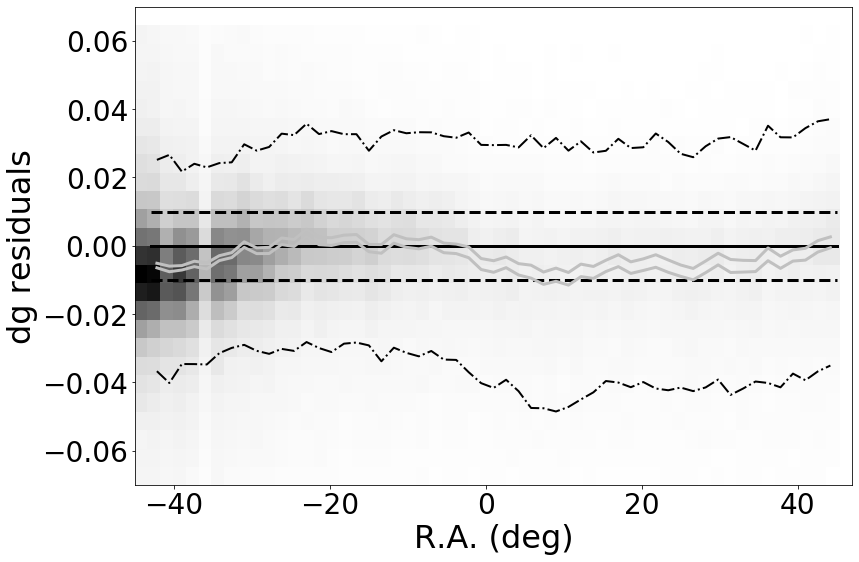

made plot colorResidPS_dg_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.001860000000000167 std.dev.All: 0.03356729999999976
N= 805889 min= -0.29989999999999906 max= 0.29999999999999927
median: -0.0016250000000020502 std.dev: 0.001368456042033855
saved plot as: colorResidPS_dg_Dec.png


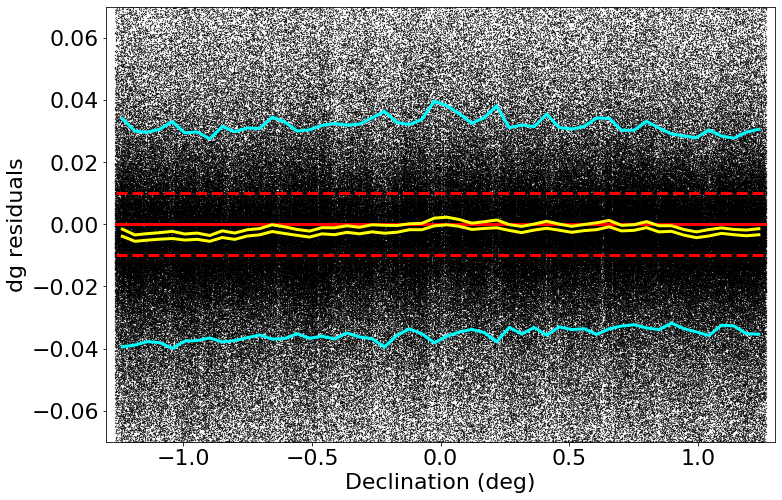

made plot colorResidPS_dg_Dec.png
medianAll: -0.001860000000000167 std.dev.All: 0.03356729999999976
N= 805889 min= -0.29989999999999906 max= 0.29999999999999927
median: -0.0018899999999998363 std.dev: 0.0013892898148884156
saved plot as: colorResidPS_dg_Dec_Hess.png


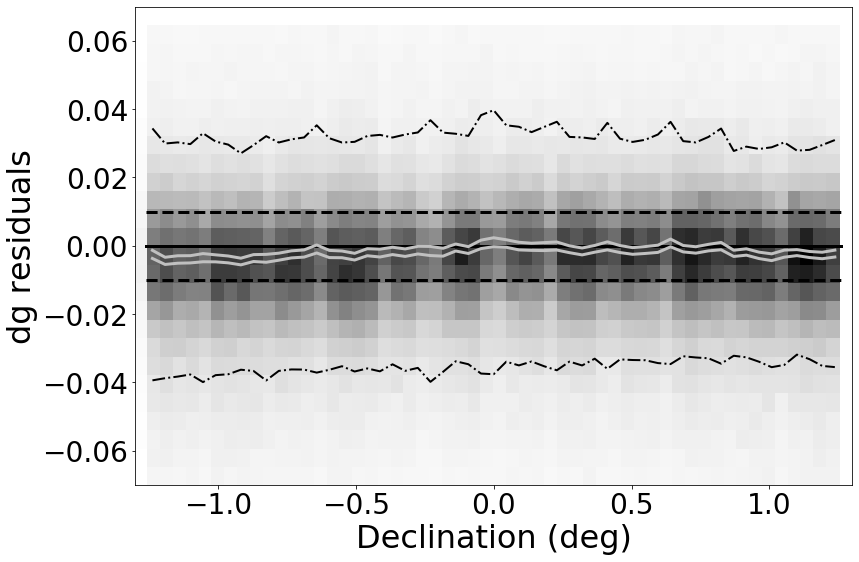

made plot colorResidPS_dg_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.001860000000000167 std.dev.All: 0.03356729999999976
N= 805889 min= -0.29989999999999906 max= 0.29999999999999927
median: -0.005488000000002297 std.dev: 0.04726515768807795
saved plot as: colorResidPS_dg_rmag.png


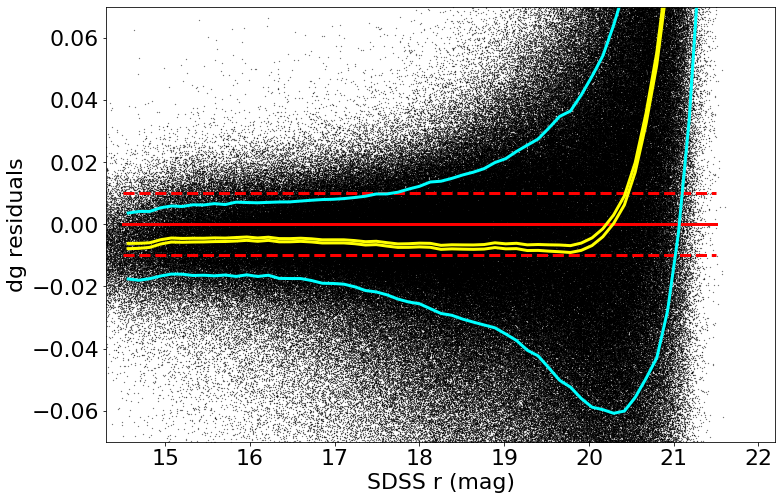

made plot colorResidPS_dg_rmag.png
medianAll: -0.001860000000000167 std.dev.All: 0.03356729999999976
N= 805889 min= -0.29989999999999906 max= 0.29999999999999927
median: -0.005488000000002297 std.dev: 0.04726515768807795
saved plot as: colorResidPS_dg_rmag_Hess.png


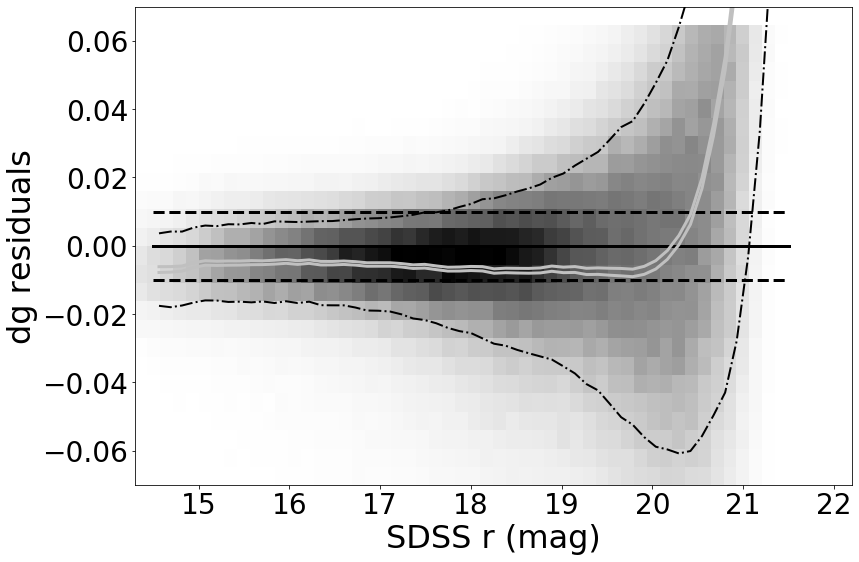

made plot colorResidPS_dg_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dr ===================
 stats for RA binning medians:
medianAll: 8.673617379884035e-18 std.dev.All: 0.018212297999999683
N= 851659 min= -0.29847800000000163 max= 0.29814199999999885
median: 0.0007909999999987494 std.dev: 0.0023197050670576767
saved plot as: colorResidPS_dr_RA.png


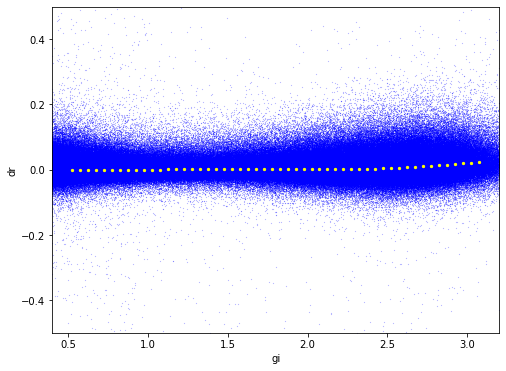

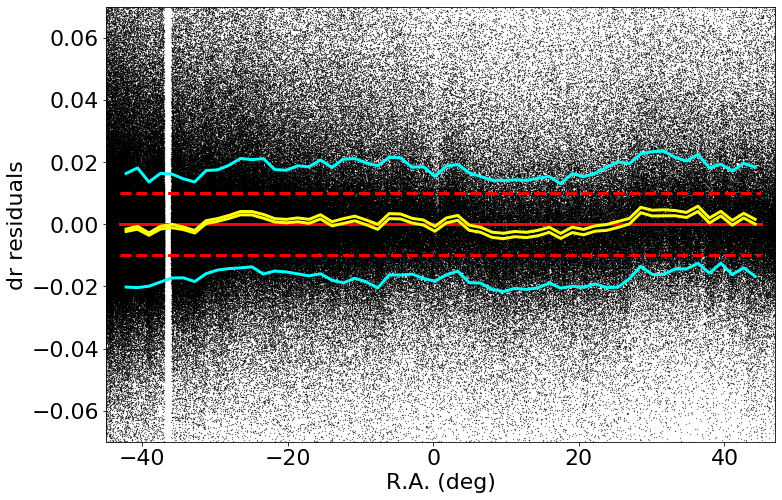

made plot colorResidPS_dr_RA.png
medianAll: 8.673617379884035e-18 std.dev.All: 0.018212297999999683
N= 851659 min= -0.29847800000000163 max= 0.29814199999999885
median: 0.0006680000000005698 std.dev: 0.002276849109102291
saved plot as: colorResidPS_dr_RA_Hess.png


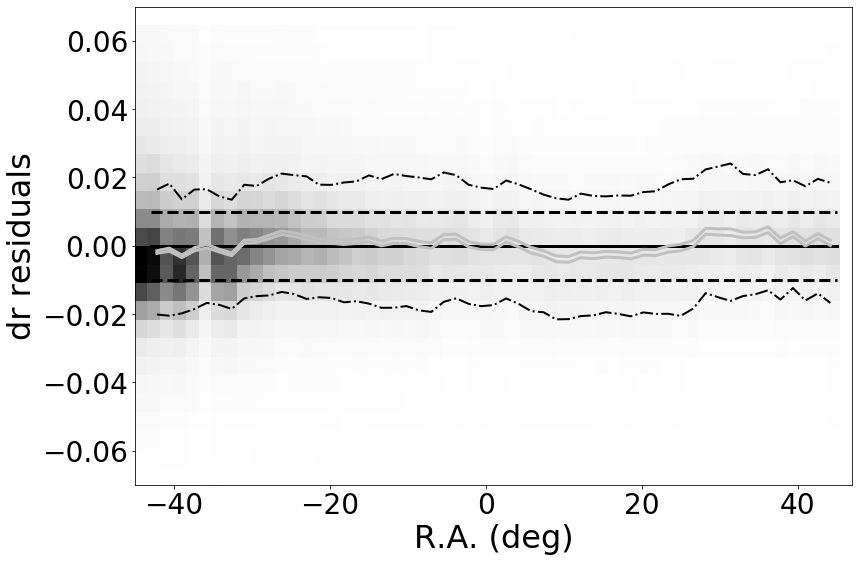

made plot colorResidPS_dr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 8.673617379884035e-18 std.dev.All: 0.018212297999999683
N= 851659 min= -0.29847800000000163 max= 0.29814199999999885
median: 0.00019600000000080062 std.dev: 0.0009492473562086758
saved plot as: colorResidPS_dr_Dec.png


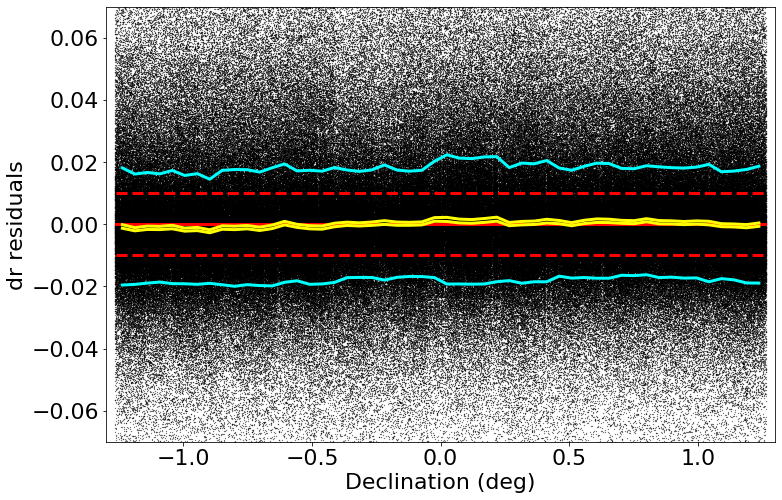

made plot colorResidPS_dr_Dec.png
medianAll: 8.673617379884035e-18 std.dev.All: 0.018212297999999683
N= 851659 min= -0.29847800000000163 max= 0.29814199999999885
median: 0.00015199999999915867 std.dev: 0.0009592768350592321
saved plot as: colorResidPS_dr_Dec_Hess.png


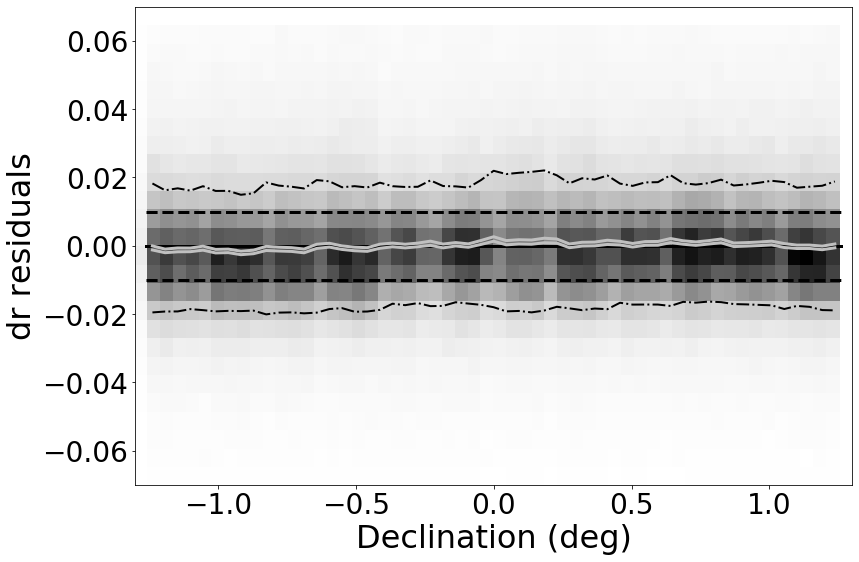

made plot colorResidPS_dr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 8.673617379884035e-18 std.dev.All: 0.018212297999999683
N= 851659 min= -0.29847800000000163 max= 0.29814199999999885
median: -0.001962999999998242 std.dev: 0.009294390312032195
saved plot as: colorResidPS_dr_rmag.png


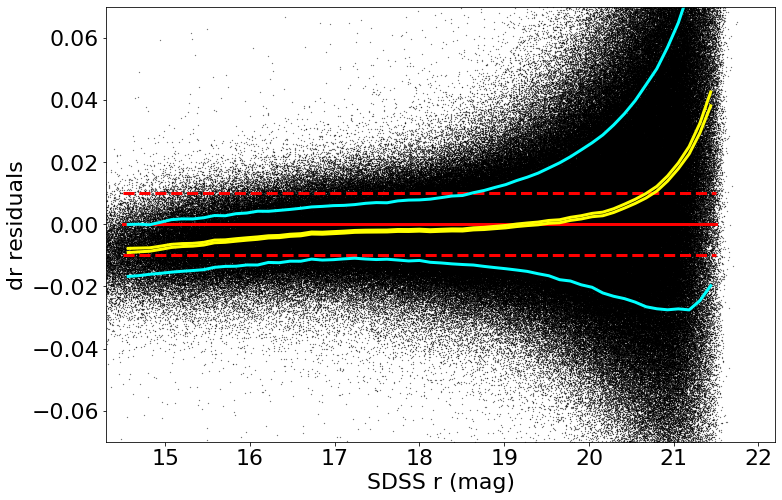

made plot colorResidPS_dr_rmag.png
medianAll: 8.673617379884035e-18 std.dev.All: 0.018212297999999683
N= 851659 min= -0.29847800000000163 max= 0.29814199999999885
median: -0.001962999999998242 std.dev: 0.009294390312032195
saved plot as: colorResidPS_dr_rmag_Hess.png


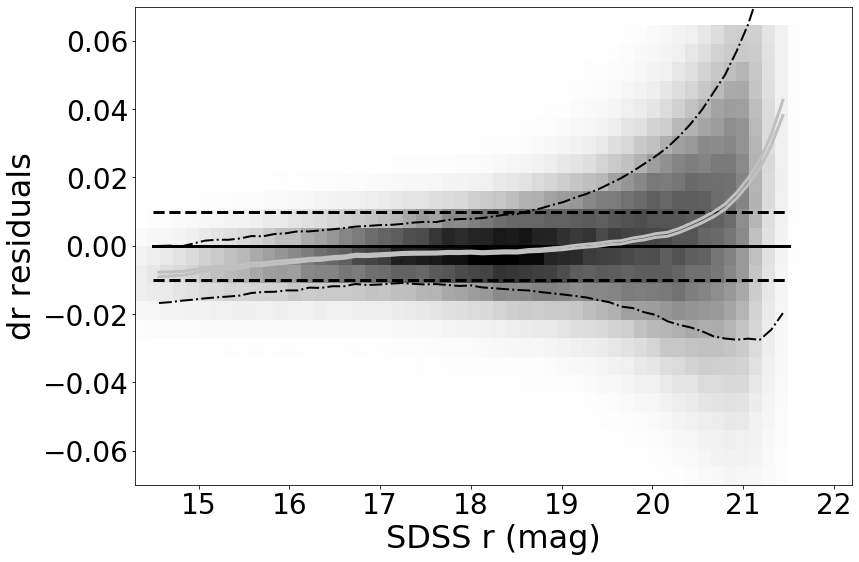

made plot colorResidPS_dr_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: di ===================
 stats for RA binning medians:
medianAll: 2.6020852139652106e-17 std.dev.All: 0.013586975999999706
N= 851729 min= -0.2999919999999995 max= 0.29914000000000196
median: -0.0013180000000005076 std.dev: 0.002114797634394253
saved plot as: colorResidPS_di_RA.png


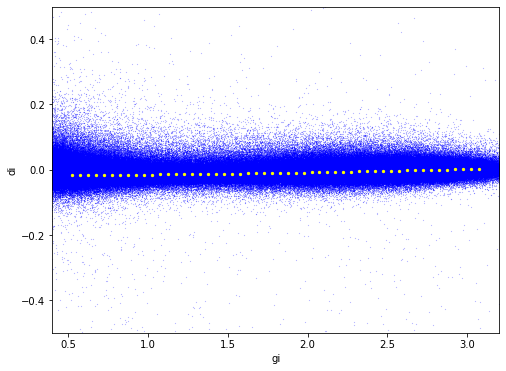

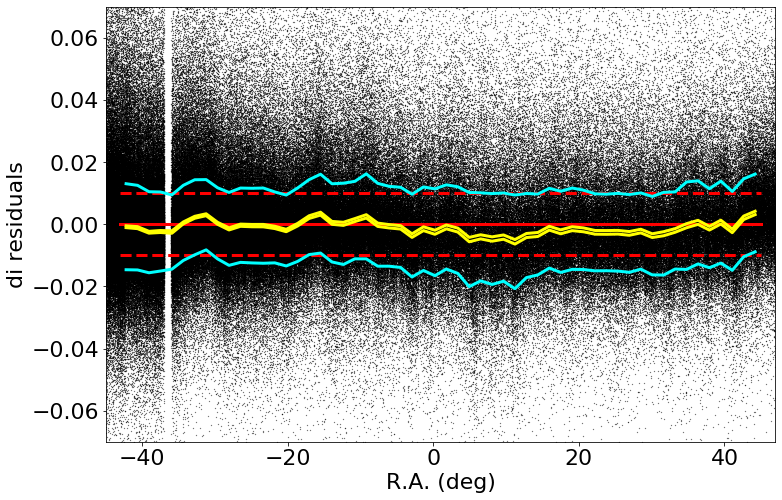

made plot colorResidPS_di_RA.png
medianAll: 2.6020852139652106e-17 std.dev.All: 0.013586975999999706
N= 851729 min= -0.2999919999999995 max= 0.29914000000000196
median: -0.001200000000000756 std.dev: 0.002134115558072184
saved plot as: colorResidPS_di_RA_Hess.png


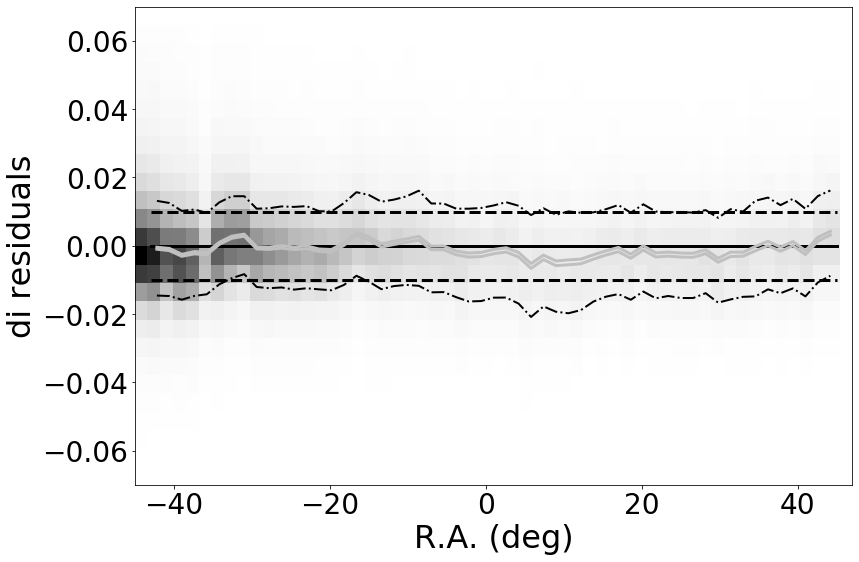

made plot colorResidPS_di_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 2.6020852139652106e-17 std.dev.All: 0.013586975999999706
N= 851729 min= -0.2999919999999995 max= 0.29914000000000196
median: 0.0002540000000025341 std.dev: 0.001106969733399299
saved plot as: colorResidPS_di_Dec.png


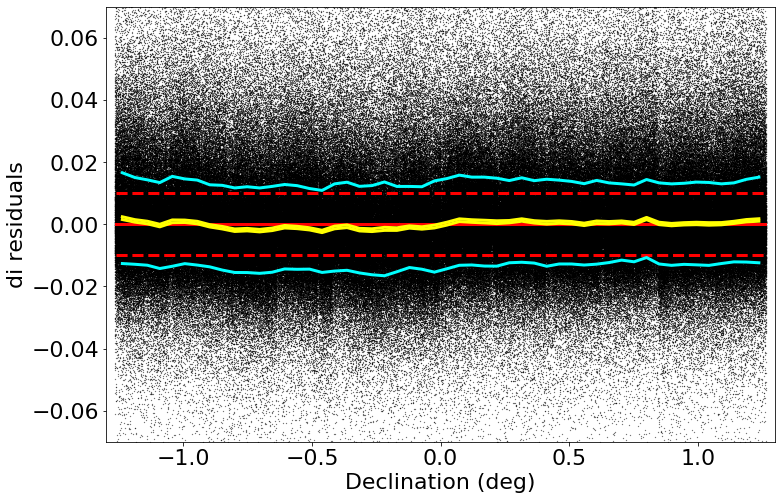

made plot colorResidPS_di_Dec.png
medianAll: 2.6020852139652106e-17 std.dev.All: 0.013586975999999706
N= 851729 min= -0.2999919999999995 max= 0.29914000000000196
median: 0.00019999999999953388 std.dev: 0.001175762560571922
saved plot as: colorResidPS_di_Dec_Hess.png


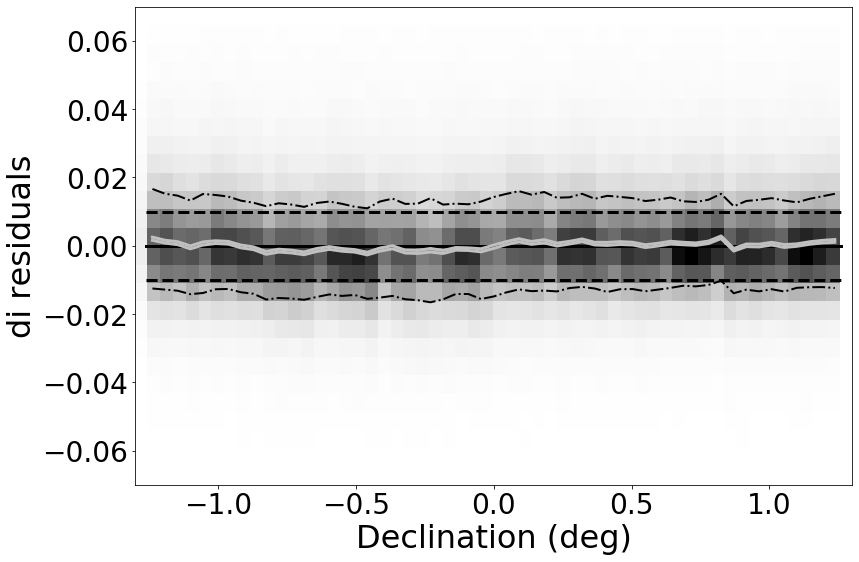

made plot colorResidPS_di_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 2.6020852139652106e-17 std.dev.All: 0.013586975999999706
N= 851729 min= -0.2999919999999995 max= 0.29914000000000196
median: -0.0007359999999982832 std.dev: 0.003953585319242166
saved plot as: colorResidPS_di_rmag.png


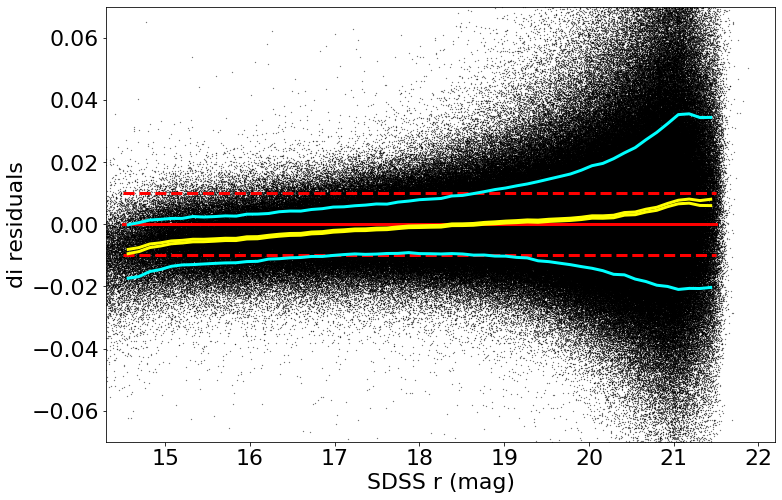

made plot colorResidPS_di_rmag.png
medianAll: 2.6020852139652106e-17 std.dev.All: 0.013586975999999706
N= 851729 min= -0.2999919999999995 max= 0.29914000000000196
median: -0.0007359999999982832 std.dev: 0.003953585319242166
saved plot as: colorResidPS_di_rmag_Hess.png


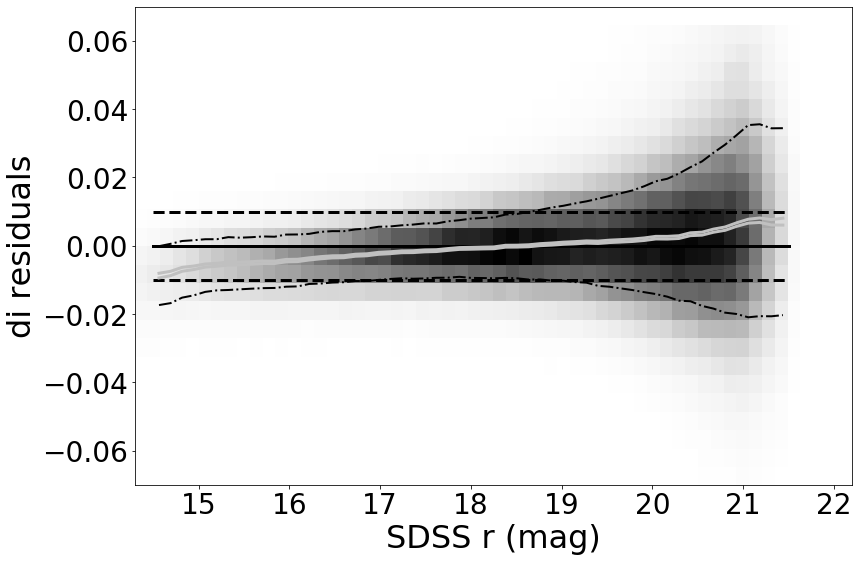

made plot colorResidPS_di_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dz ===================
 stats for RA binning medians:
medianAll: -1.1999999999633831e-05 std.dev.All: 0.02145046799999798
N= 850186 min= -0.29939599999999883 max= 0.2999699999999979
median: -0.004700000000001812 std.dev: 0.005310507110445299
saved plot as: colorResidPS_dz_RA.png


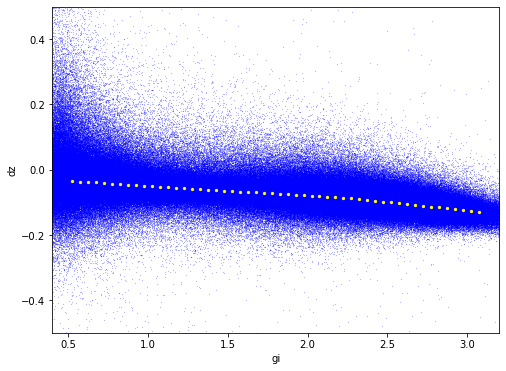

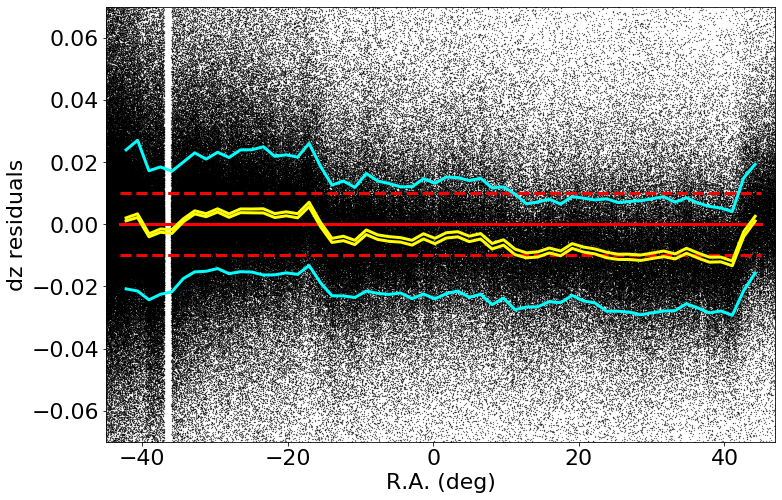

made plot colorResidPS_dz_RA.png
medianAll: -1.1999999999633831e-05 std.dev.All: 0.02145046799999798
N= 850186 min= -0.29939599999999883 max= 0.2999699999999979
median: -0.005027000000000649 std.dev: 0.0052739210888018305
saved plot as: colorResidPS_dz_RA_Hess.png


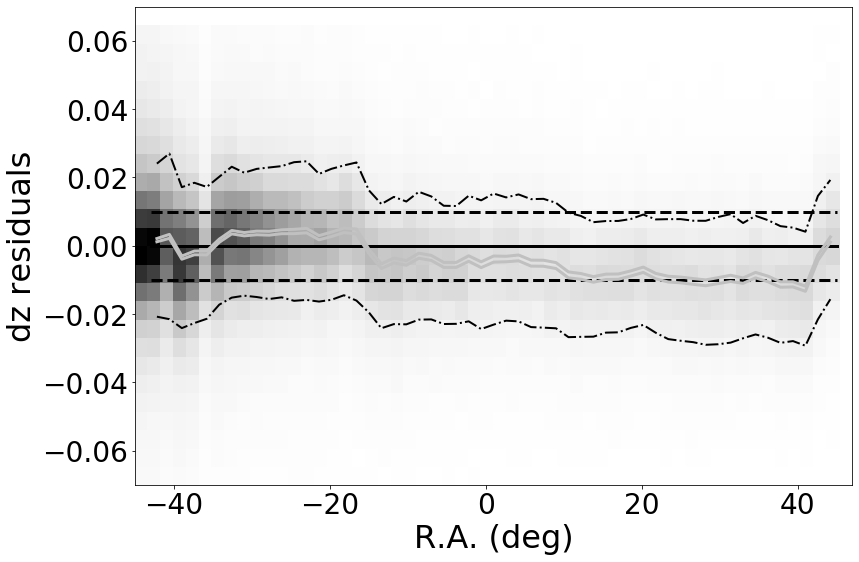

made plot colorResidPS_dz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -1.1999999999633831e-05 std.dev.All: 0.02145046799999798
N= 850186 min= -0.29939599999999883 max= 0.2999699999999979
median: 0.00029799999999929536 std.dev: 0.0030678683048690966
saved plot as: colorResidPS_dz_Dec.png


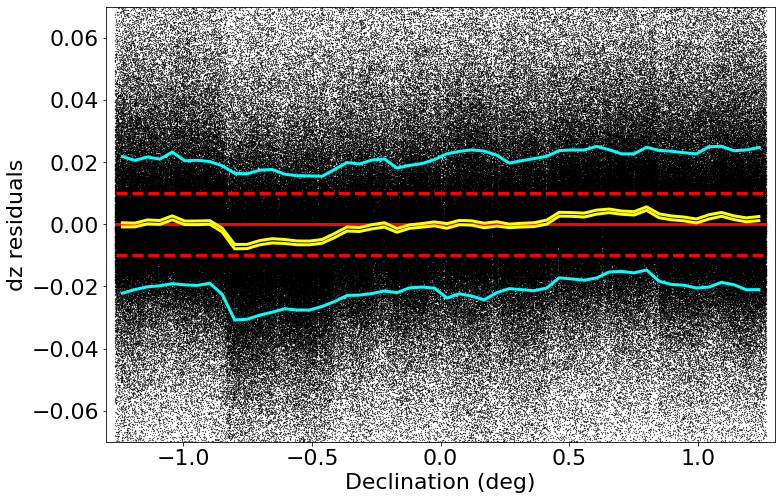

made plot colorResidPS_dz_Dec.png
medianAll: -1.1999999999633831e-05 std.dev.All: 0.02145046799999798
N= 850186 min= -0.29939599999999883 max= 0.2999699999999979
median: 0.0003440000000003232 std.dev: 0.0031126423292362425
saved plot as: colorResidPS_dz_Dec_Hess.png


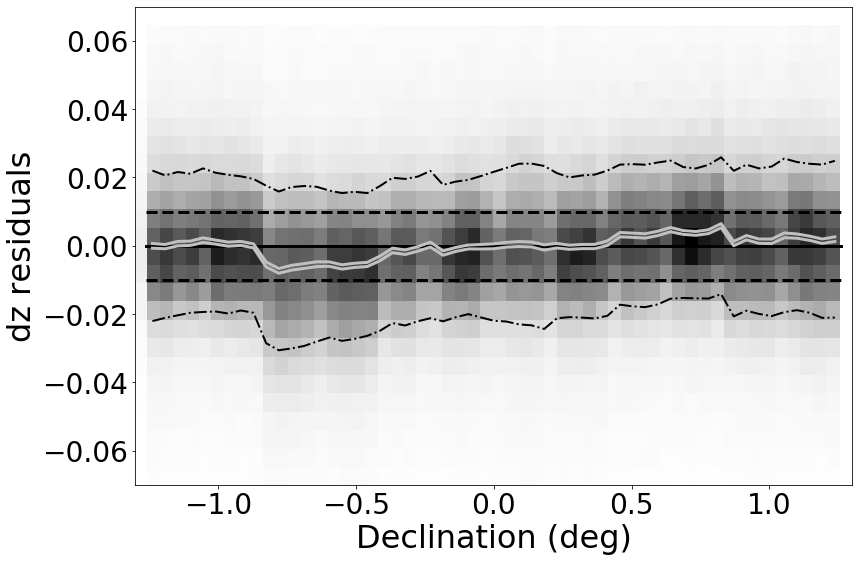

made plot colorResidPS_dz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -1.1999999999633831e-05 std.dev.All: 0.02145046799999798
N= 850186 min= -0.29939599999999883 max= 0.2999699999999979
median: -6.800000000099088e-05 std.dev: 0.0018370376926720026
saved plot as: colorResidPS_dz_rmag.png


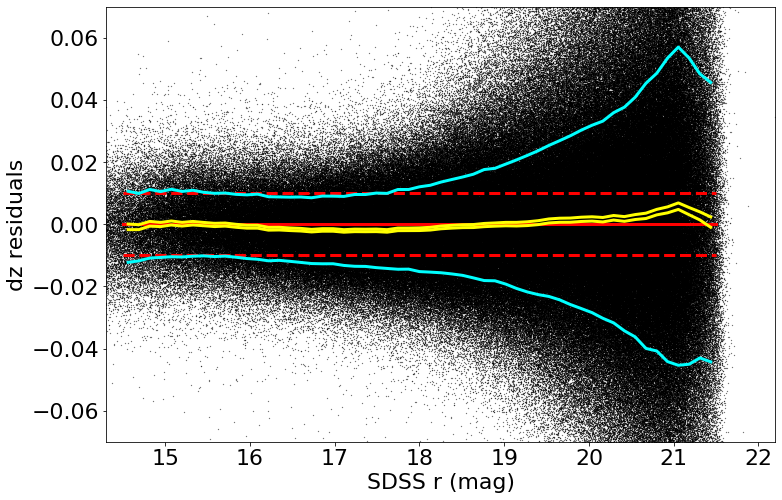

made plot colorResidPS_dz_rmag.png
medianAll: -1.1999999999633831e-05 std.dev.All: 0.02145046799999798
N= 850186 min= -0.29939599999999883 max= 0.2999699999999979
median: -6.800000000099088e-05 std.dev: 0.0018370376926720026
saved plot as: colorResidPS_dz_rmag_Hess.png


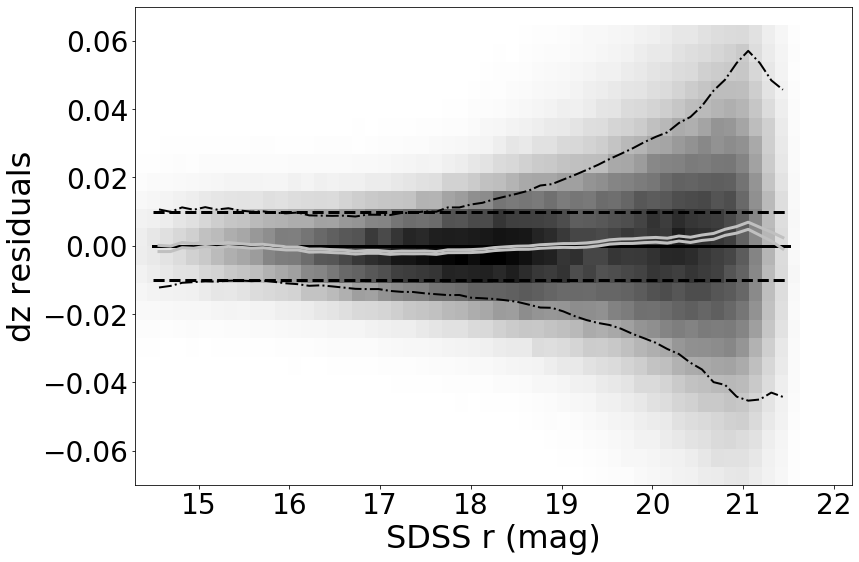

made plot colorResidPS_dz_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dgr ===================
 stats for RA binning medians:
medianAll: -0.001739999999999381 std.dev.All: 0.03349023600000294
N= 811011 min= -0.2997040000000003 max= 0.29999999999999893
median: -0.004248000000001938 std.dev: 0.0031230318411863355
saved plot as: colorResidPS_dgr_RA.png


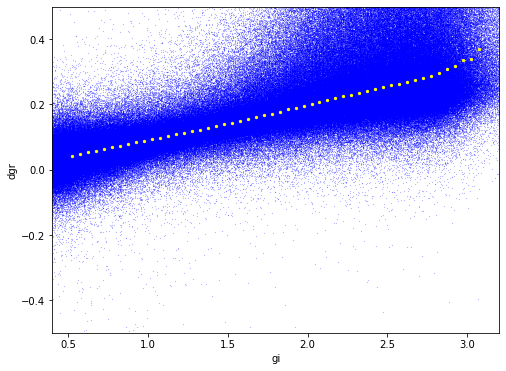

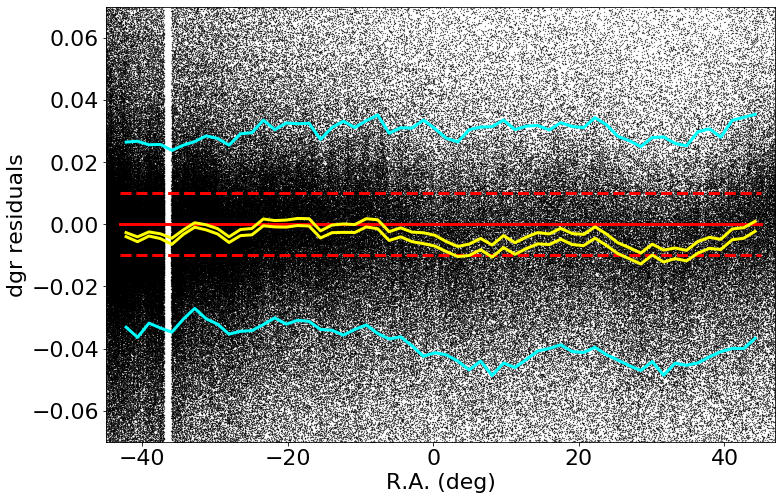

made plot colorResidPS_dgr_RA.png
medianAll: -0.001739999999999381 std.dev.All: 0.03349023600000294
N= 811011 min= -0.2997040000000003 max= 0.29999999999999893
median: -0.0041329999999995745 std.dev: 0.0031011408737233546
saved plot as: colorResidPS_dgr_RA_Hess.png


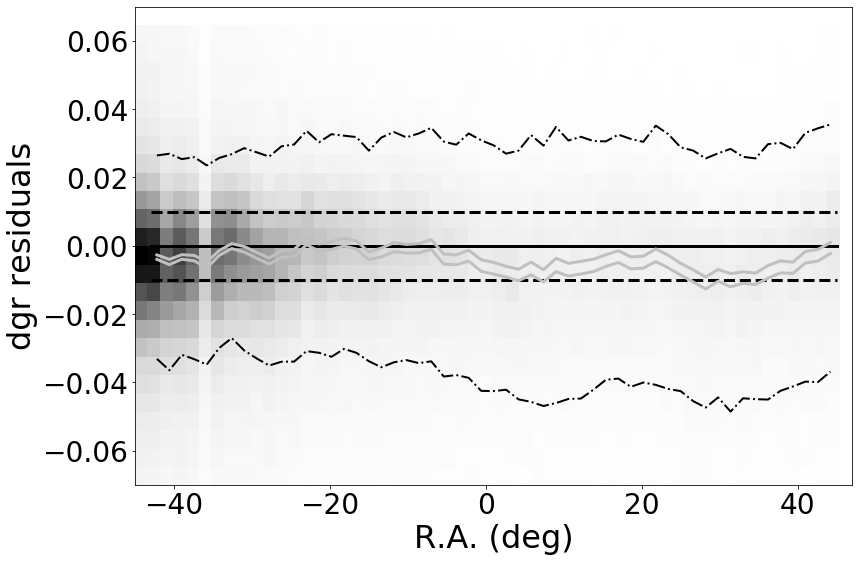

made plot colorResidPS_dgr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.001739999999999381 std.dev.All: 0.03349023600000294
N= 811011 min= -0.2997040000000003 max= 0.29999999999999893
median: -0.001686999999999092 std.dev: 0.000953351745897151
saved plot as: colorResidPS_dgr_Dec.png


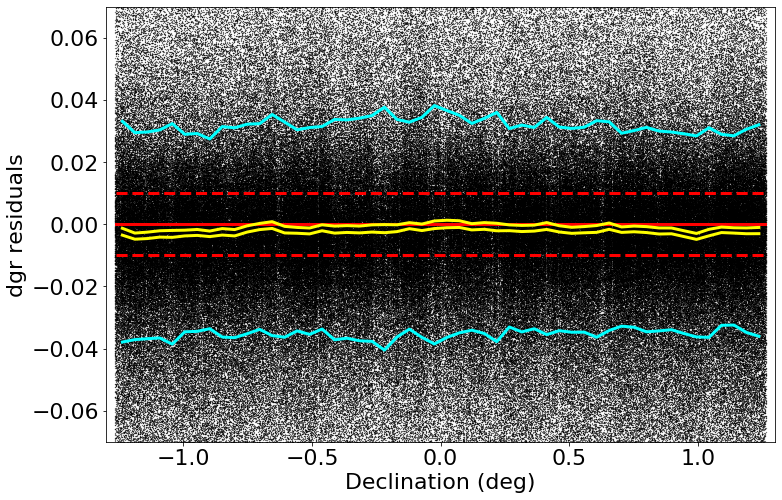

made plot colorResidPS_dgr_Dec.png
medianAll: -0.001739999999999381 std.dev.All: 0.03349023600000294
N= 811011 min= -0.2997040000000003 max= 0.29999999999999893
median: -0.001618999999995152 std.dev: 0.0009807279428319237
saved plot as: colorResidPS_dgr_Dec_Hess.png


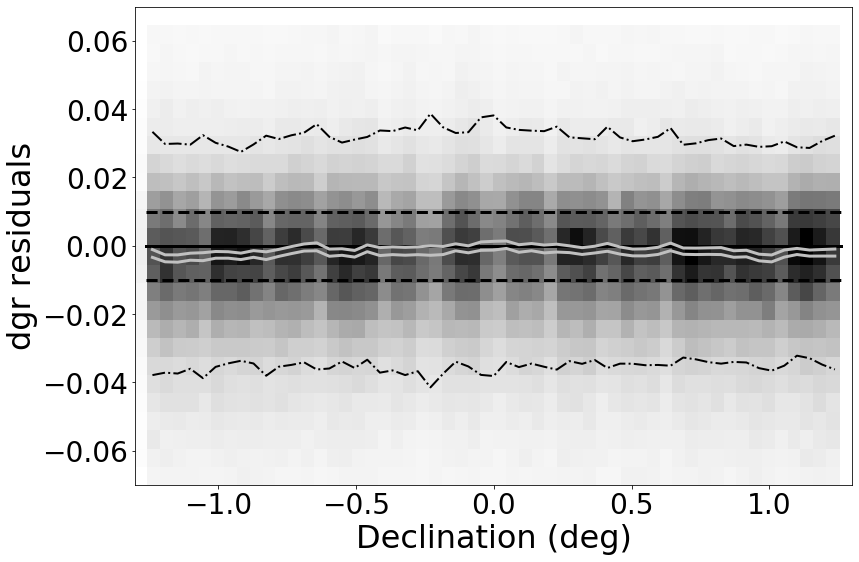

made plot colorResidPS_dgr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.001739999999999381 std.dev.All: 0.03349023600000294
N= 811011 min= -0.2997040000000003 max= 0.29999999999999893
median: -0.003624000000004693 std.dev: 0.04260599732290834
saved plot as: colorResidPS_dgr_rmag.png


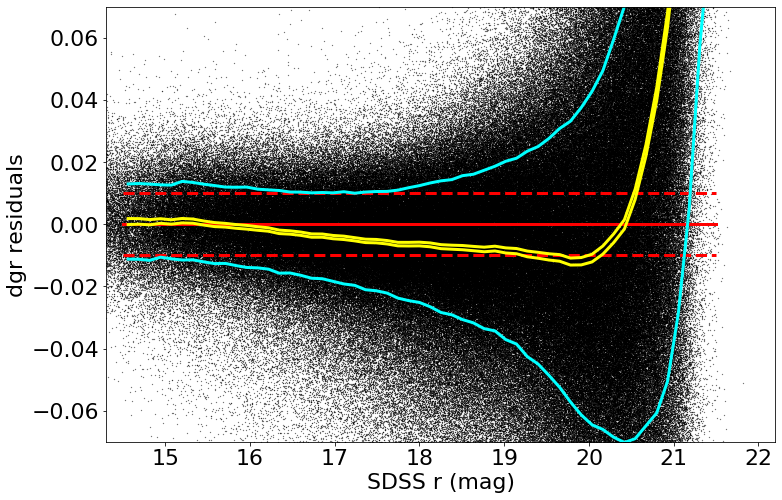

made plot colorResidPS_dgr_rmag.png
medianAll: -0.001739999999999381 std.dev.All: 0.03349023600000294
N= 811011 min= -0.2997040000000003 max= 0.29999999999999893
median: -0.003624000000004693 std.dev: 0.04260599732290834
saved plot as: colorResidPS_dgr_rmag_Hess.png


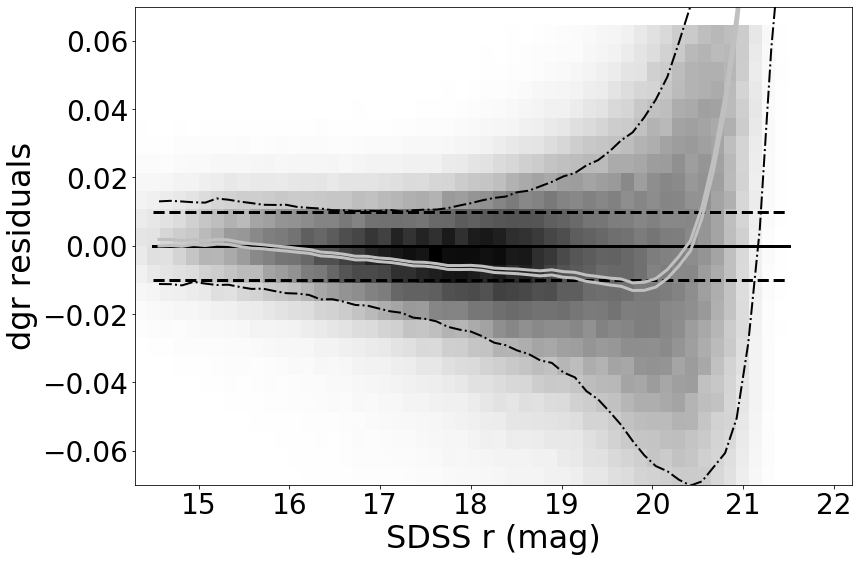

made plot colorResidPS_dgr_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dri ===================
 stats for RA binning medians:
medianAll: -1.9897278269453977e-15 std.dev.All: 0.0193878945000015
N= 852251 min= -0.29973200000000133 max= 0.2964659999999996
median: 0.0018574999999988284 std.dev: 0.002581907109310733
saved plot as: colorResidPS_dri_RA.png


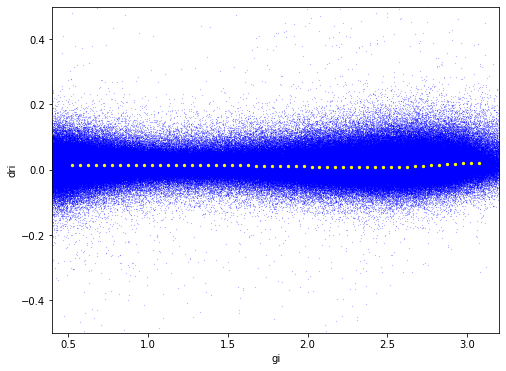

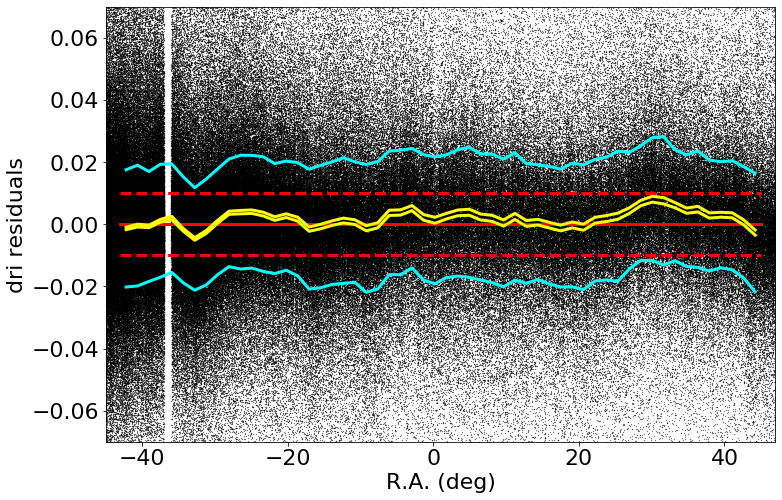

made plot colorResidPS_dri_RA.png
medianAll: -1.9897278269453977e-15 std.dev.All: 0.0193878945000015
N= 852251 min= -0.29973200000000133 max= 0.2964659999999996
median: 0.0017420000000000066 std.dev: 0.0025902086661535226
saved plot as: colorResidPS_dri_RA_Hess.png


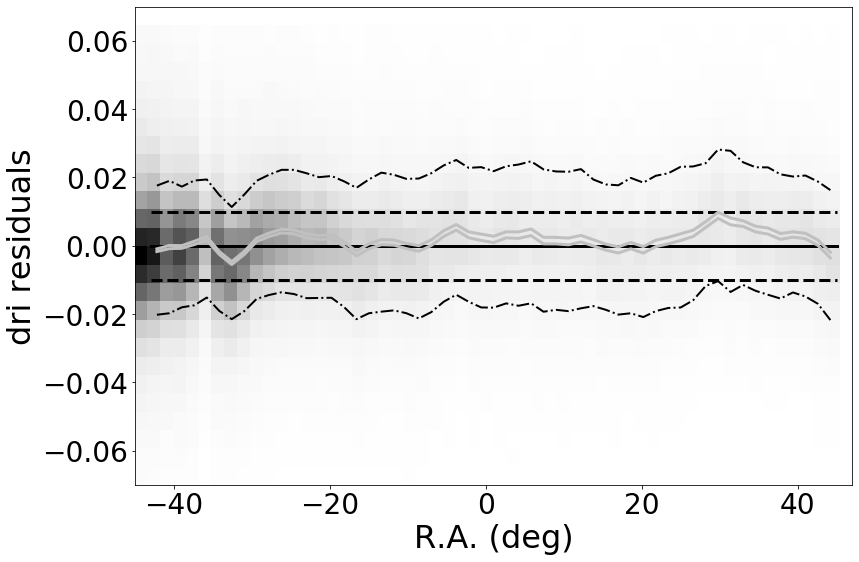

made plot colorResidPS_dri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -1.9897278269453977e-15 std.dev.All: 0.0193878945000015
N= 852251 min= -0.29973200000000133 max= 0.2964659999999996
median: 0.00024400000000110184 std.dev: 0.0011335622362591434
saved plot as: colorResidPS_dri_Dec.png


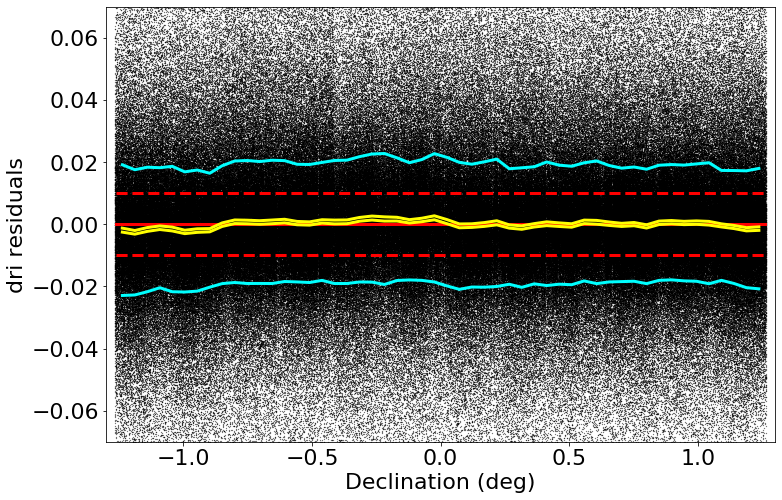

made plot colorResidPS_dri_Dec.png
medianAll: -1.9897278269453977e-15 std.dev.All: 0.0193878945000015
N= 852251 min= -0.29973200000000133 max= 0.2964659999999996
median: 0.0001879999999977889 std.dev: 0.0011959301669125743
saved plot as: colorResidPS_dri_Dec_Hess.png


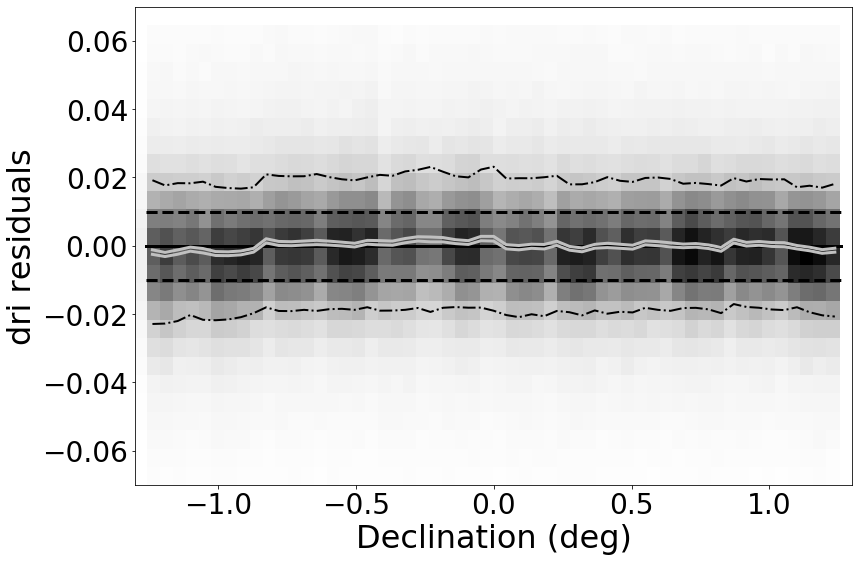

made plot colorResidPS_dri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -1.9897278269453977e-15 std.dev.All: 0.0193878945000015
N= 852251 min= -0.29973200000000133 max= 0.2964659999999996
median: -0.0007440000000008967 std.dev: 0.006017002844378101
saved plot as: colorResidPS_dri_rmag.png


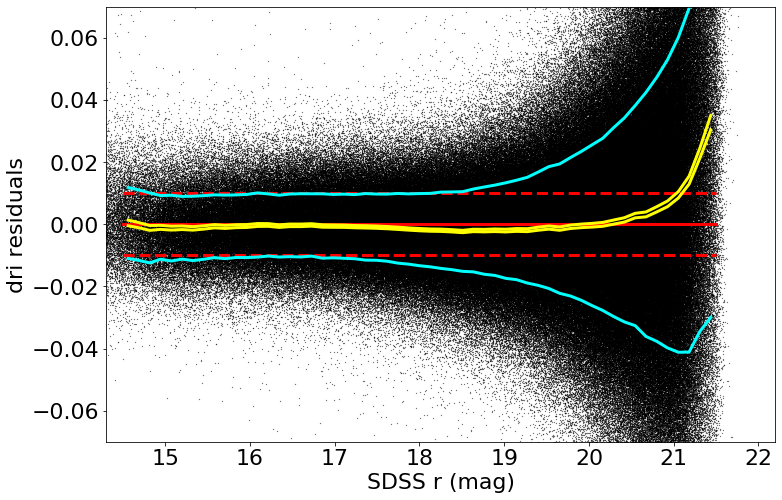

made plot colorResidPS_dri_rmag.png
medianAll: -1.9897278269453977e-15 std.dev.All: 0.0193878945000015
N= 852251 min= -0.29973200000000133 max= 0.2964659999999996
median: -0.0007440000000008967 std.dev: 0.006017002844378101
saved plot as: colorResidPS_dri_rmag_Hess.png


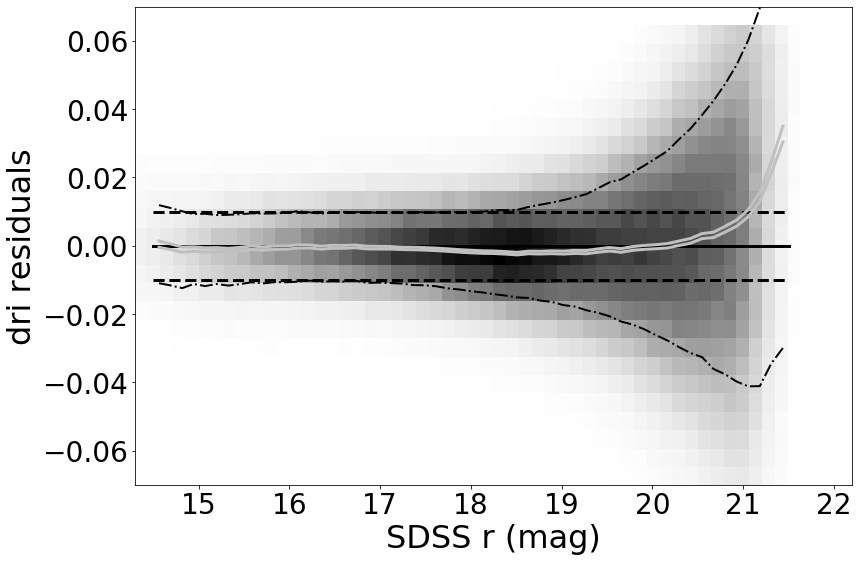

made plot colorResidPS_dri_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: diz ===================
 stats for RA binning medians:
medianAll: 8.000000000916996e-06 std.dev.All: 0.022828727999999753
N= 851377 min= -0.29994999999999905 max= 0.2992270000000007
median: 0.0034809999999995313 std.dev: 0.004583244191277923
saved plot as: colorResidPS_diz_RA.png


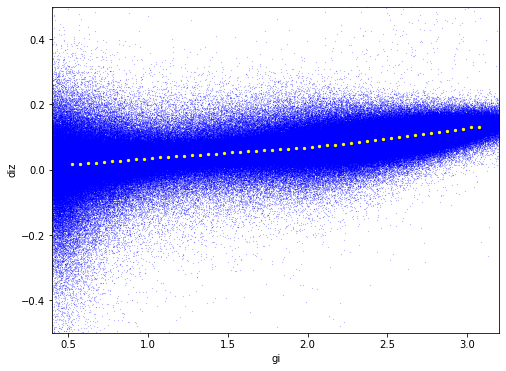

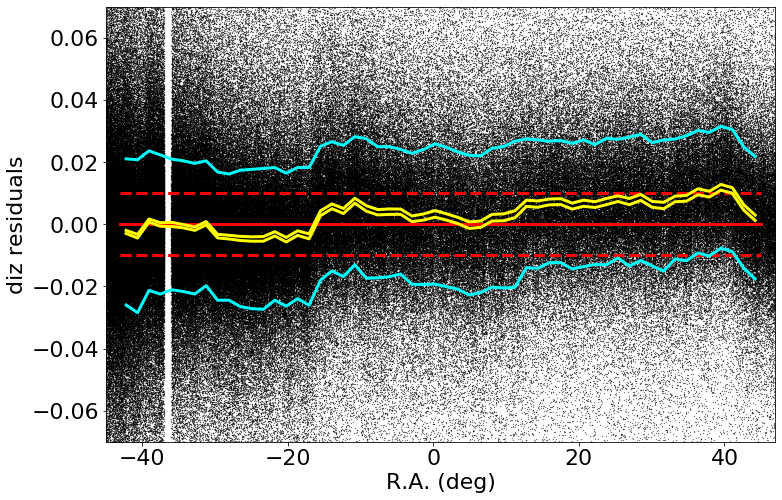

made plot colorResidPS_diz_RA.png
medianAll: 8.000000000916996e-06 std.dev.All: 0.022828727999999753
N= 851377 min= -0.29994999999999905 max= 0.2992270000000007
median: 0.003180000000001973 std.dev: 0.004571097596460259
saved plot as: colorResidPS_diz_RA_Hess.png


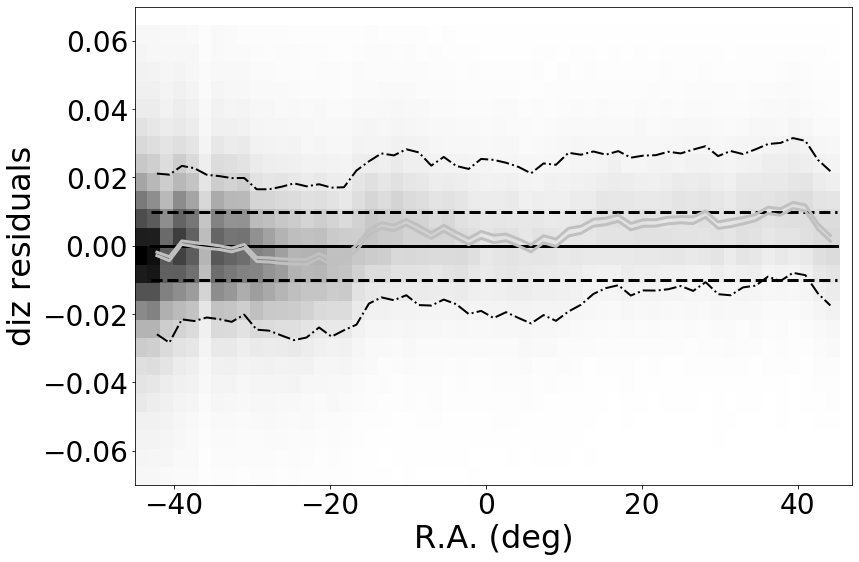

made plot colorResidPS_diz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 8.000000000916996e-06 std.dev.All: 0.022828727999999753
N= 851377 min= -0.29994999999999905 max= 0.2992270000000007
median: -0.00026450000000000085 std.dev: 0.002440120837319285
saved plot as: colorResidPS_diz_Dec.png


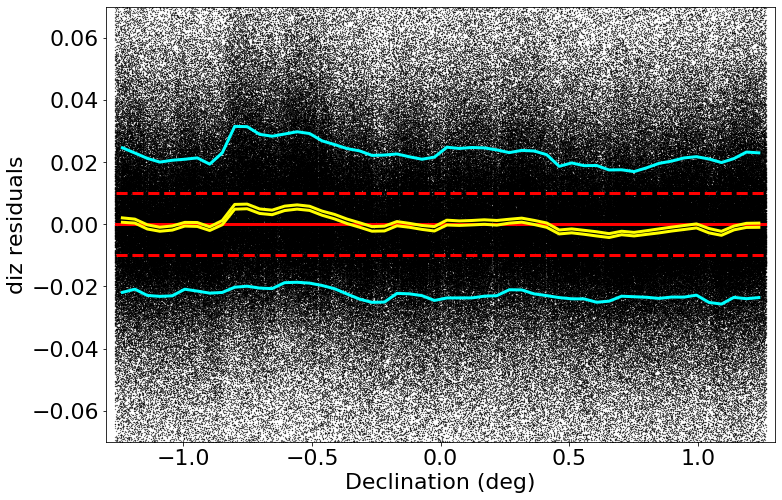

made plot colorResidPS_diz_Dec.png
medianAll: 8.000000000916996e-06 std.dev.All: 0.022828727999999753
N= 851377 min= -0.29994999999999905 max= 0.2992270000000007
median: -0.0003440000000026408 std.dev: 0.002458237855298886
saved plot as: colorResidPS_diz_Dec_Hess.png


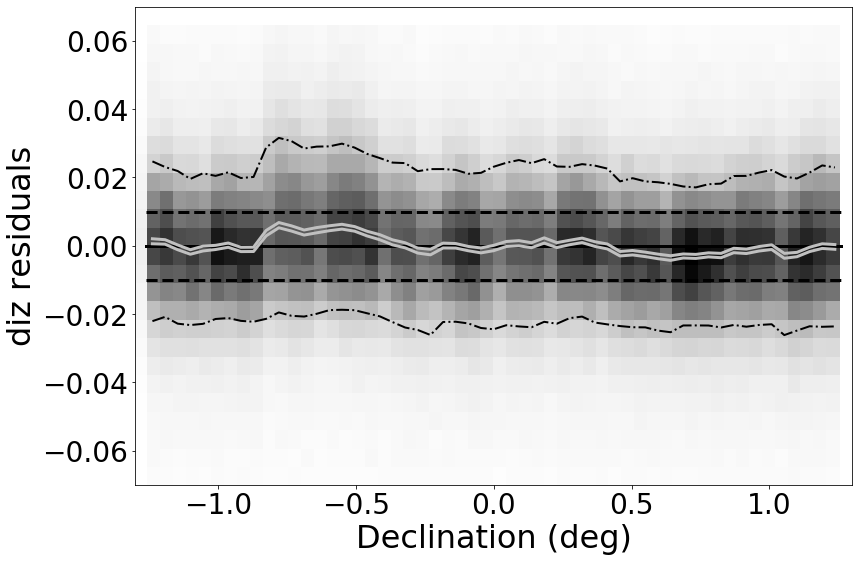

made plot colorResidPS_diz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 8.000000000916996e-06 std.dev.All: 0.022828727999999753
N= 851377 min= -0.29994999999999905 max= 0.2992270000000007
median: 0.0005520000000031906 std.dev: 0.002750727265606043
saved plot as: colorResidPS_diz_rmag.png


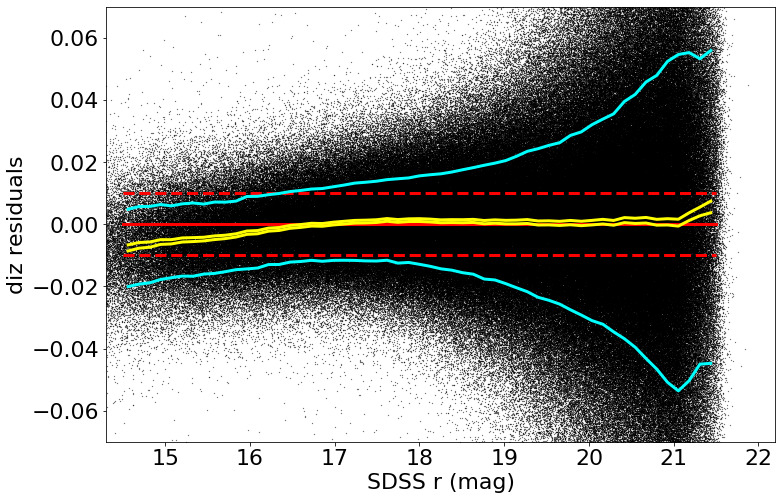

made plot colorResidPS_diz_rmag.png
medianAll: 8.000000000916996e-06 std.dev.All: 0.022828727999999753
N= 851377 min= -0.29994999999999905 max= 0.2992270000000007
median: 0.0005520000000031906 std.dev: 0.002750727265606043
saved plot as: colorResidPS_diz_rmag_Hess.png


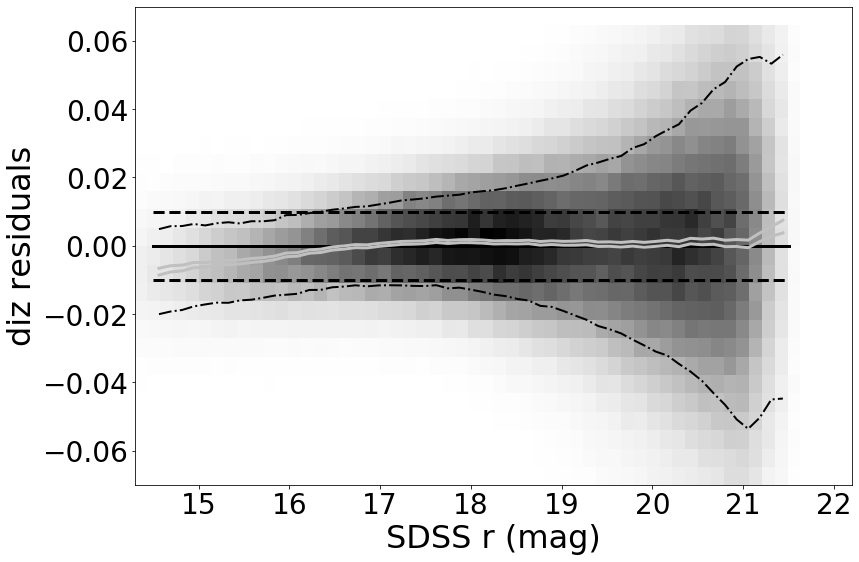

made plot colorResidPS_diz_rmag_Hess.png
------------------------------------------------------------------


In [13]:
keywords = {"Xstr":'gi', "plotNameRoot":'colorResidPS_', "symbSize":0.05}
for color in ('dg', 'dr', 'di', 'dz', 'dgr', 'dri', 'diz'):
    keywords["Ystr"] = color 
    doOneColor(sdssPS, keywords)

=========== WORKING ON: dg ===================
 stats for RA binning medians:
medianAll: -1.599999999957885e-05 std.dev.All: 0.017268263999999894
N= 509155 min= -0.29861999999999983 max= 0.2998699999999991
median: -0.0003200000000006323 std.dev: 0.0032921546124123533
saved plot as: colorResidPSDR2v42bright_dg_RA.png


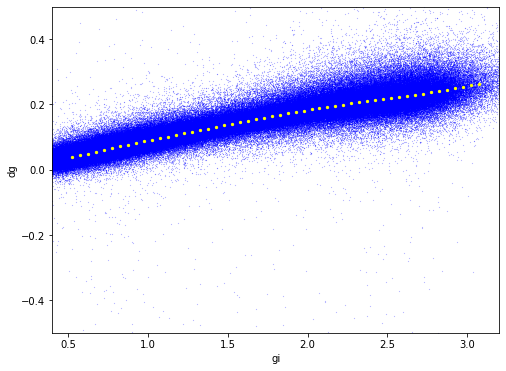

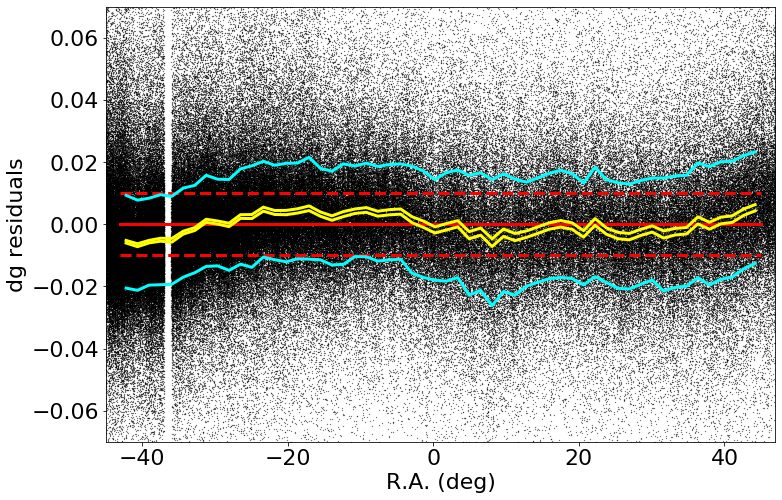

made plot colorResidPSDR2v42bright_dg_RA.png
medianAll: -1.599999999957885e-05 std.dev.All: 0.017268263999999894
N= 509155 min= -0.29861999999999983 max= 0.2998699999999991
median: -0.0005239999999991987 std.dev: 0.0032723231183533897
saved plot as: colorResidPSDR2v42bright_dg_RA_Hess.png


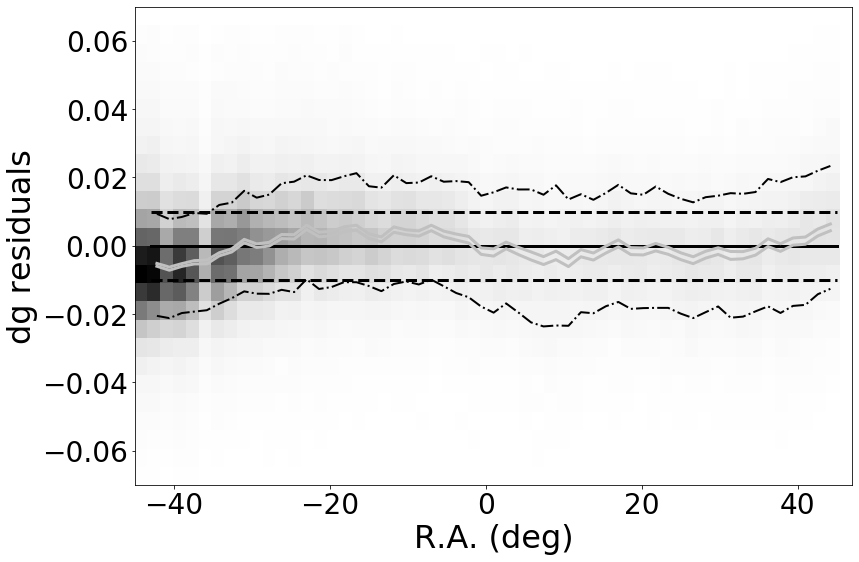

made plot colorResidPSDR2v42bright_dg_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -1.599999999957885e-05 std.dev.All: 0.017268263999999894
N= 509155 min= -0.29861999999999983 max= 0.2998699999999991
median: 3.750000000043649e-05 std.dev: 0.0015361187571829328
saved plot as: colorResidPSDR2v42bright_dg_Dec.png


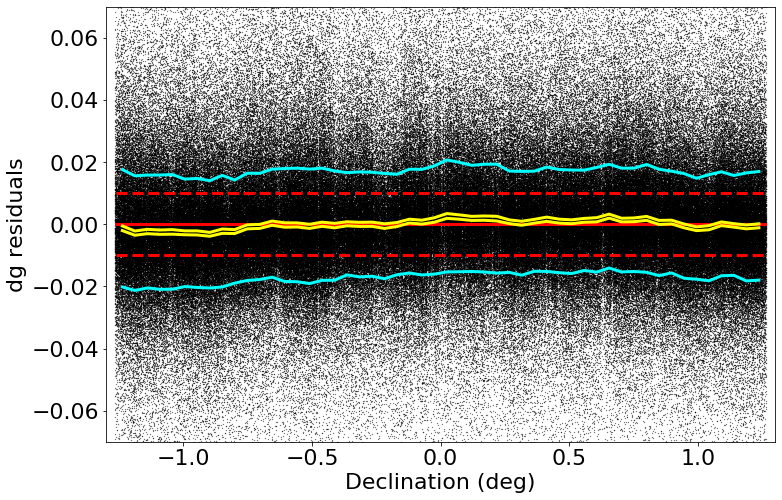

made plot colorResidPSDR2v42bright_dg_Dec.png
medianAll: -1.599999999957885e-05 std.dev.All: 0.017268263999999894
N= 509155 min= -0.29861999999999983 max= 0.2998699999999991
median: 0.00017600000000030092 std.dev: 0.0015567983941409038
saved plot as: colorResidPSDR2v42bright_dg_Dec_Hess.png


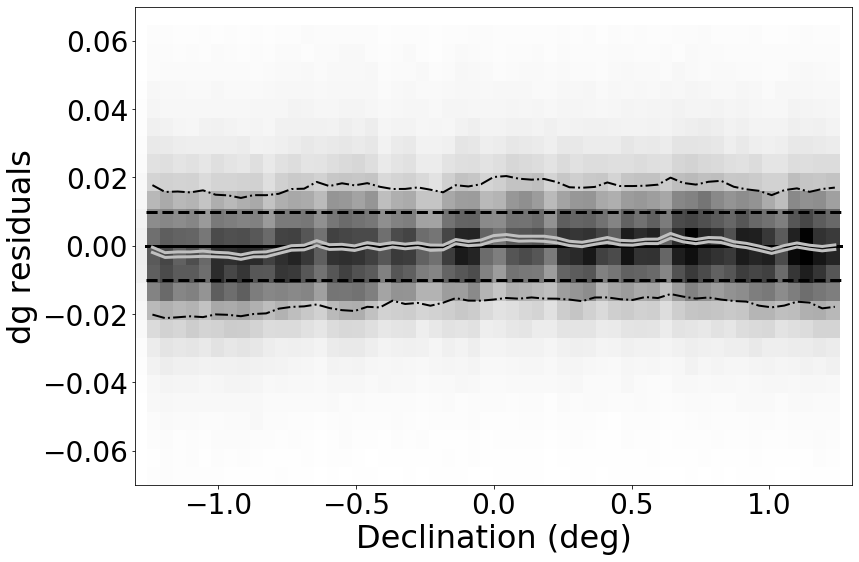

made plot colorResidPSDR2v42bright_dg_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -1.599999999957885e-05 std.dev.All: 0.017268263999999894
N= 509155 min= -0.29861999999999983 max= 0.2998699999999991
median: -0.0014149999999990698 std.dev: 0.0038352413570113793
saved plot as: colorResidPSDR2v42bright_dg_rmag.png


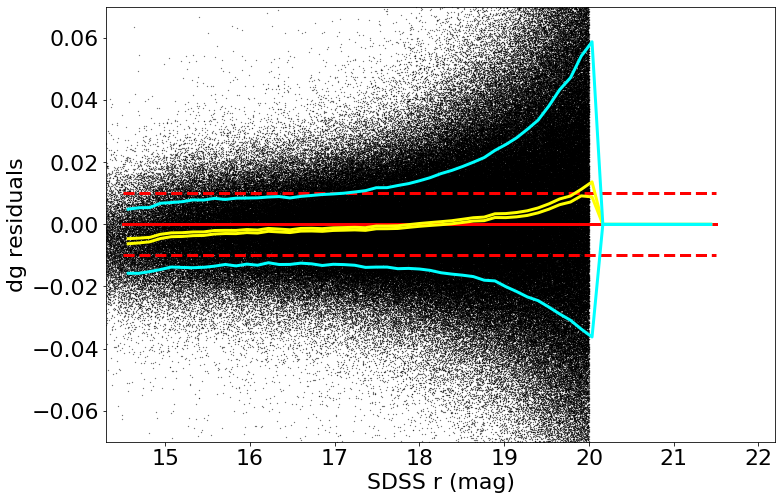

made plot colorResidPSDR2v42bright_dg_rmag.png
medianAll: -1.599999999957885e-05 std.dev.All: 0.017268263999999894
N= 509155 min= -0.29861999999999983 max= 0.2998699999999991
median: -0.0014149999999990698 std.dev: 0.0038352413570113793
saved plot as: colorResidPSDR2v42bright_dg_rmag_Hess.png


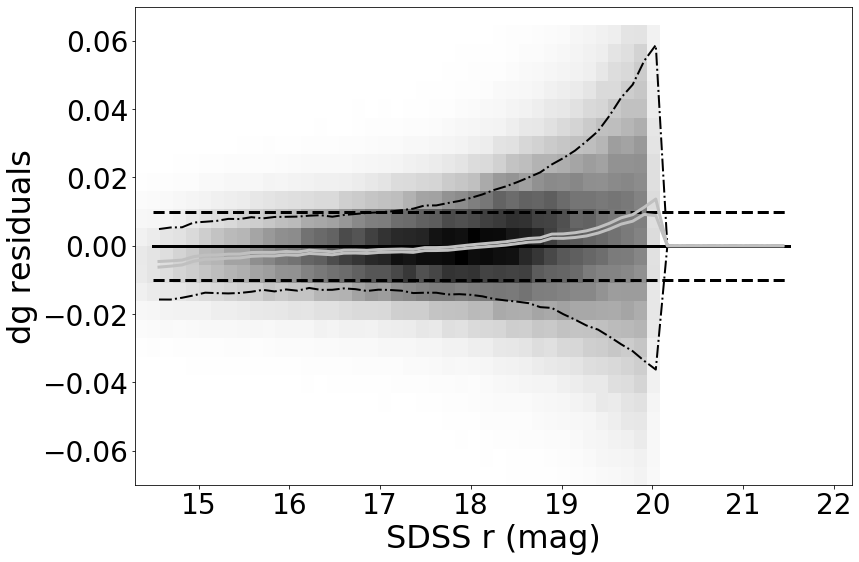

made plot colorResidPSDR2v42bright_dg_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dr ===================
 stats for RA binning medians:
medianAll: 8.00000000061125e-06 std.dev.All: 0.011567009999998915
N= 509226 min= -0.29971000000000136 max= 0.29671399999999903
median: 0.0011919999999994875 std.dev: 0.002166706305203893
saved plot as: colorResidPSDR2v42bright_dr_RA.png


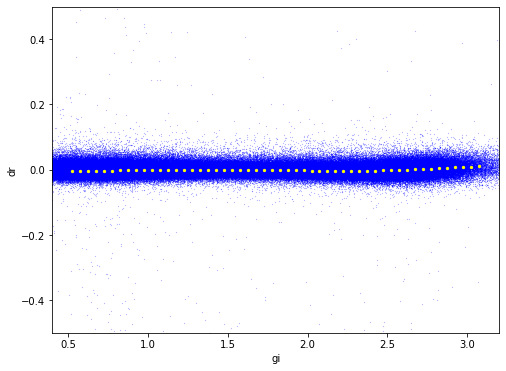

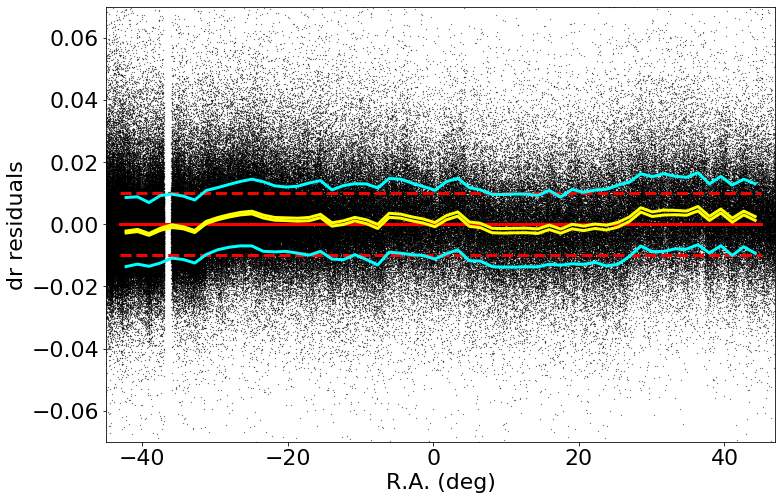

made plot colorResidPSDR2v42bright_dr_RA.png
medianAll: 8.00000000061125e-06 std.dev.All: 0.011567009999998915
N= 509226 min= -0.29971000000000136 max= 0.29671399999999903
median: 0.0010409999999975723 std.dev: 0.002124318671211573
saved plot as: colorResidPSDR2v42bright_dr_RA_Hess.png


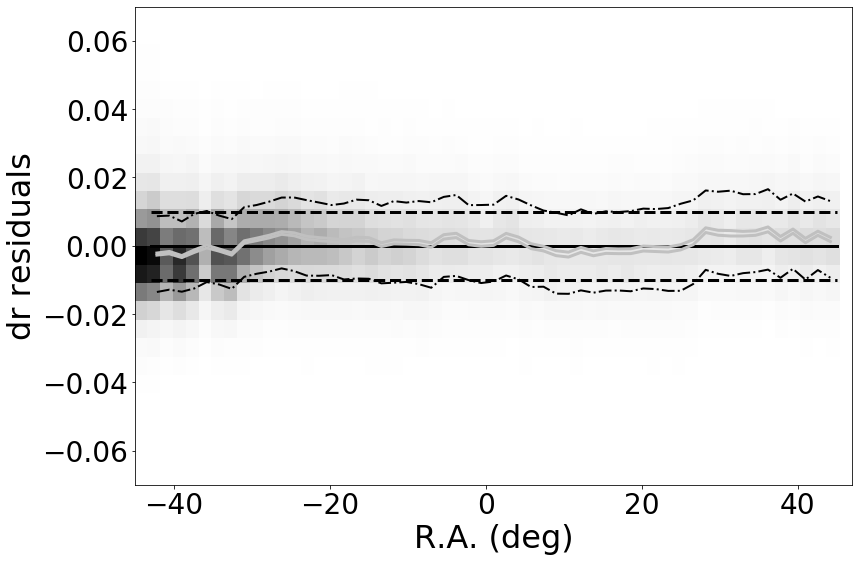

made plot colorResidPSDR2v42bright_dr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 8.00000000061125e-06 std.dev.All: 0.011567009999998915
N= 509226 min= -0.29971000000000136 max= 0.29671399999999903
median: 0.0003939999999979536 std.dev: 0.0009064107158044259
saved plot as: colorResidPSDR2v42bright_dr_Dec.png


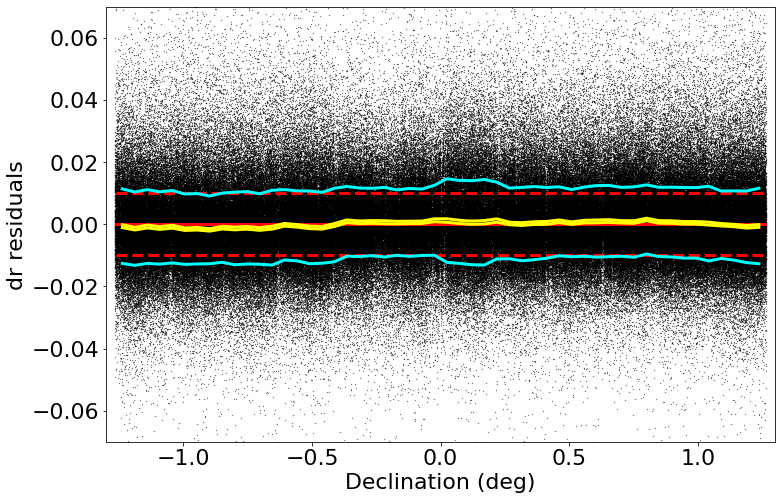

made plot colorResidPSDR2v42bright_dr_Dec.png
medianAll: 8.00000000061125e-06 std.dev.All: 0.011567009999998915
N= 509226 min= -0.29971000000000136 max= 0.29671399999999903
median: 0.00035399999999927395 std.dev: 0.0009163964380855881
saved plot as: colorResidPSDR2v42bright_dr_Dec_Hess.png


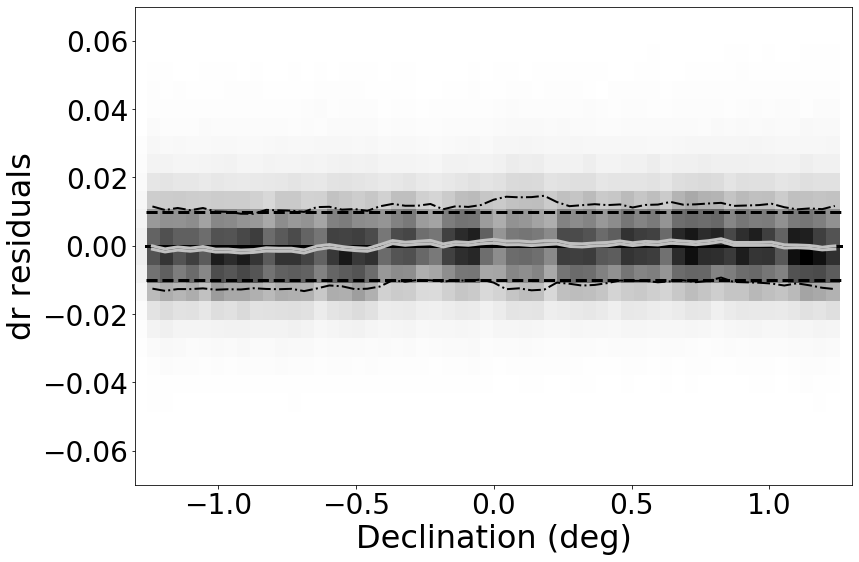

made plot colorResidPSDR2v42bright_dr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 8.00000000061125e-06 std.dev.All: 0.011567009999998915
N= 509226 min= -0.29971000000000136 max= 0.29671399999999903
median: -0.00026649999999976627 std.dev: 0.003465216492571682
saved plot as: colorResidPSDR2v42bright_dr_rmag.png


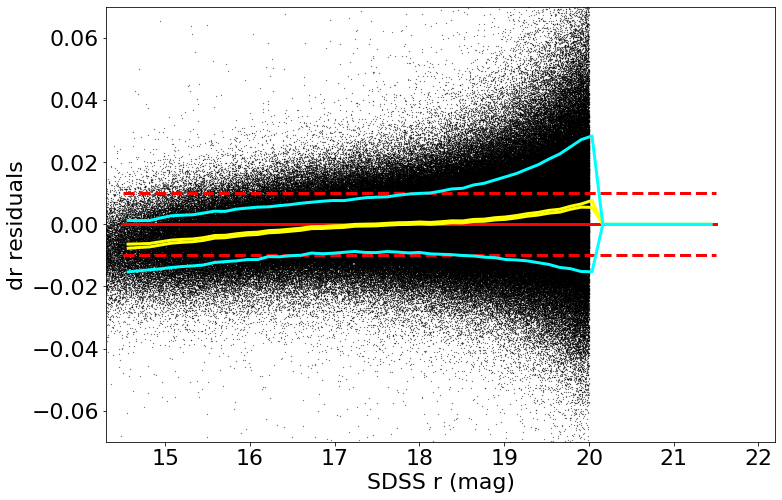

made plot colorResidPSDR2v42bright_dr_rmag.png
medianAll: 8.00000000061125e-06 std.dev.All: 0.011567009999998915
N= 509226 min= -0.29971000000000136 max= 0.29671399999999903
median: -0.00026649999999976627 std.dev: 0.003465216492571682
saved plot as: colorResidPSDR2v42bright_dr_rmag_Hess.png


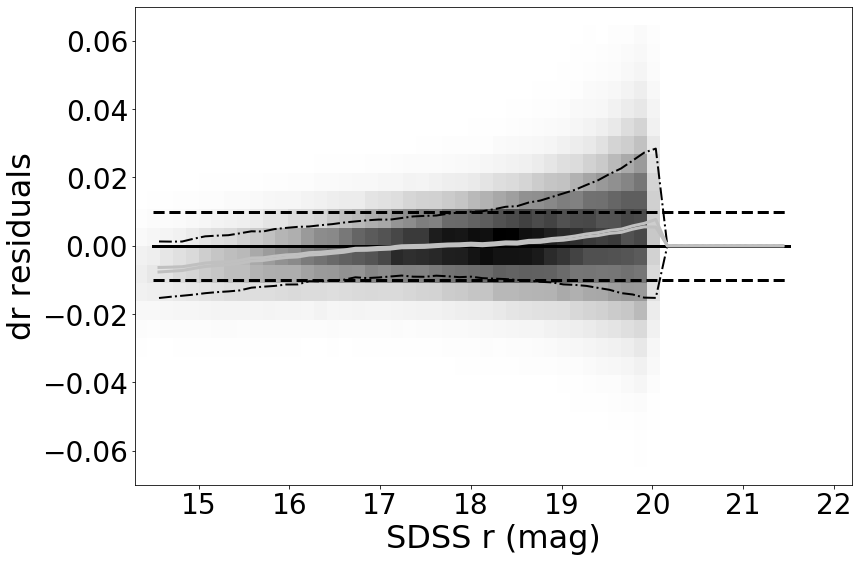

made plot colorResidPSDR2v42bright_dr_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: di ===================
 stats for RA binning medians:
medianAll: 2.000000000248461e-05 std.dev.All: 0.009924953999998926
N= 509258 min= -0.2993559999999987 max= 0.29935600000000223
median: -0.0012689999999987004 std.dev: 0.002219339468692312
saved plot as: colorResidPSDR2v42bright_di_RA.png


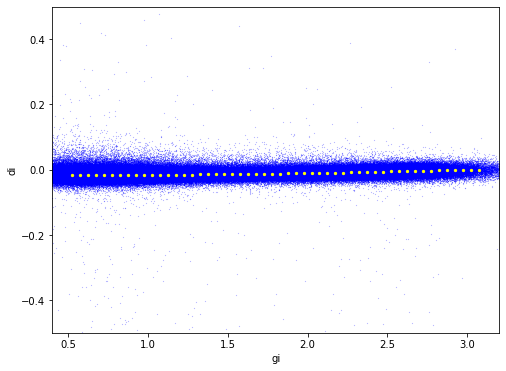

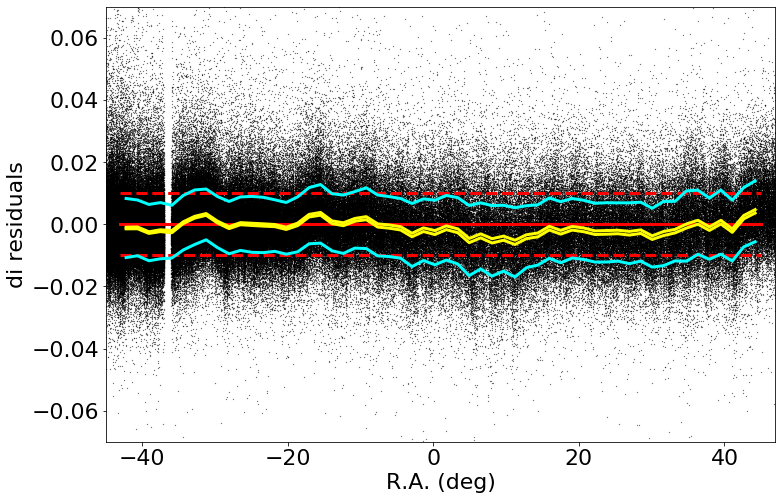

made plot colorResidPSDR2v42bright_di_RA.png
medianAll: 2.000000000248461e-05 std.dev.All: 0.009924953999998926
N= 509258 min= -0.2993559999999987 max= 0.29935600000000223
median: -0.0011600000000008513 std.dev: 0.0022186546232320077
saved plot as: colorResidPSDR2v42bright_di_RA_Hess.png


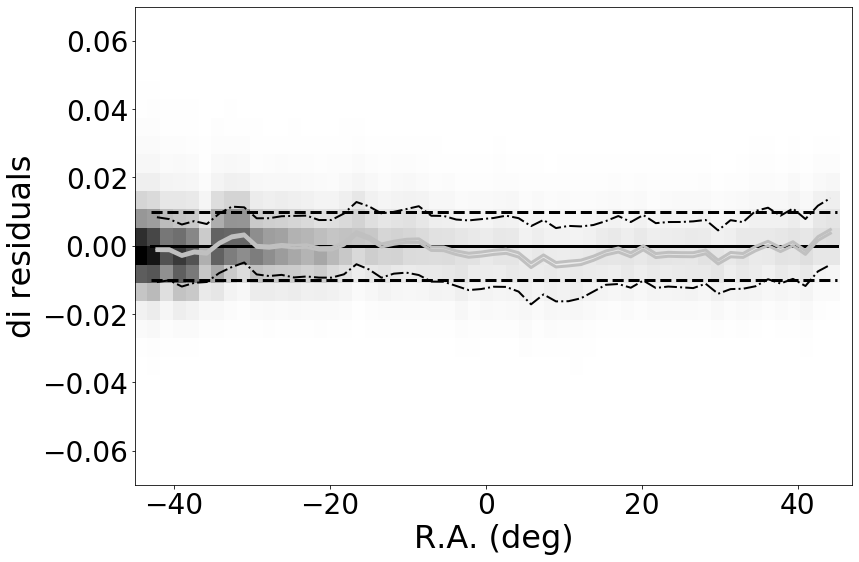

made plot colorResidPSDR2v42bright_di_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 2.000000000248461e-05 std.dev.All: 0.009924953999998926
N= 509258 min= -0.2993559999999987 max= 0.29935600000000223
median: 0.00015500000000119802 std.dev: 0.0009117599941771504
saved plot as: colorResidPSDR2v42bright_di_Dec.png


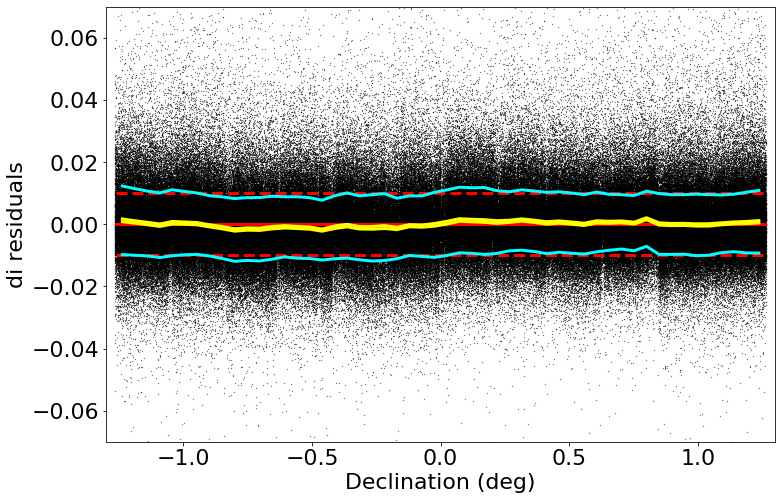

made plot colorResidPSDR2v42bright_di_Dec.png
medianAll: 2.000000000248461e-05 std.dev.All: 0.009924953999998926
N= 509258 min= -0.2993559999999987 max= 0.29935600000000223
median: 0.00016999999999604484 std.dev: 0.0009928691646844785
saved plot as: colorResidPSDR2v42bright_di_Dec_Hess.png


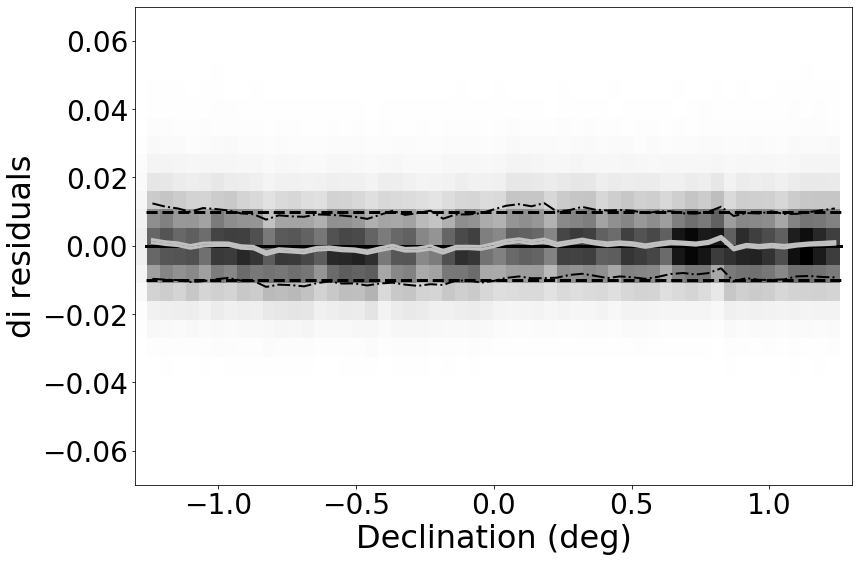

made plot colorResidPSDR2v42bright_di_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 2.000000000248461e-05 std.dev.All: 0.009924953999998926
N= 509258 min= -0.2993559999999987 max= 0.29935600000000223
median: -0.0004710000000011901 std.dev: 0.0030452525665722284
saved plot as: colorResidPSDR2v42bright_di_rmag.png


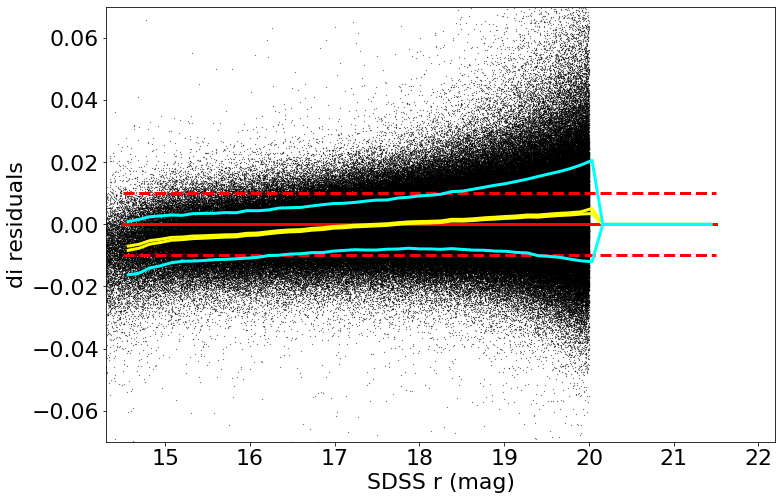

made plot colorResidPSDR2v42bright_di_rmag.png
medianAll: 2.000000000248461e-05 std.dev.All: 0.009924953999998926
N= 509258 min= -0.2993559999999987 max= 0.29935600000000223
median: -0.0004710000000011901 std.dev: 0.0030452525665722284
saved plot as: colorResidPSDR2v42bright_di_rmag_Hess.png


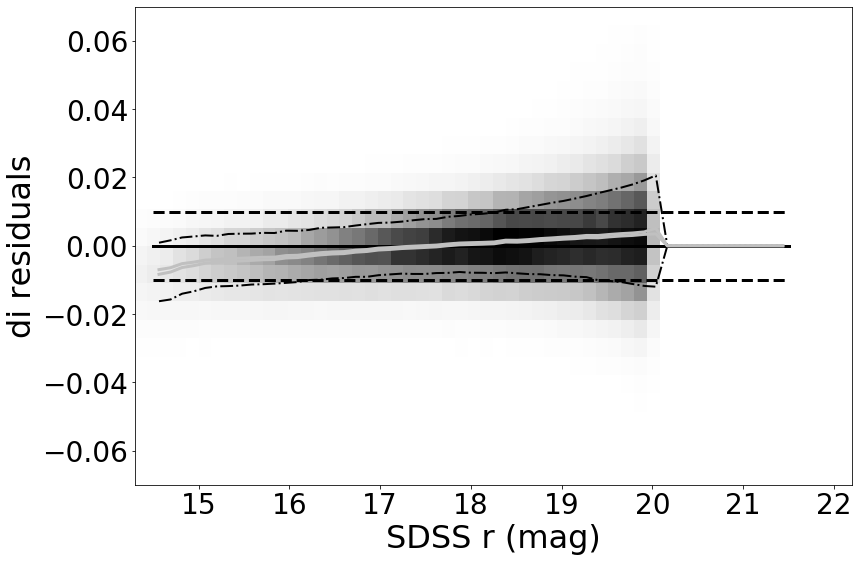

made plot colorResidPSDR2v42bright_di_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dz ===================
 stats for RA binning medians:
medianAll: 2.0000000000706952e-05 std.dev.All: 0.015169752000000104
N= 509216 min= -0.2980839999999993 max= 0.2985399999999991
median: -0.004312999999999264 std.dev: 0.005185946276509673
saved plot as: colorResidPSDR2v42bright_dz_RA.png


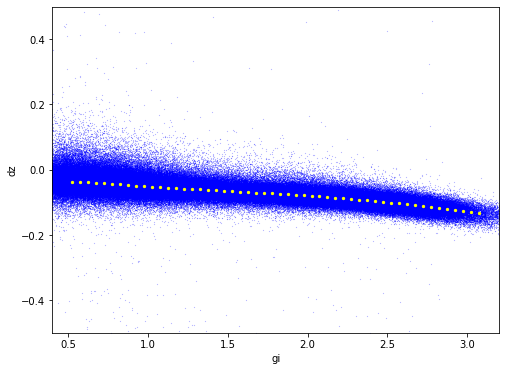

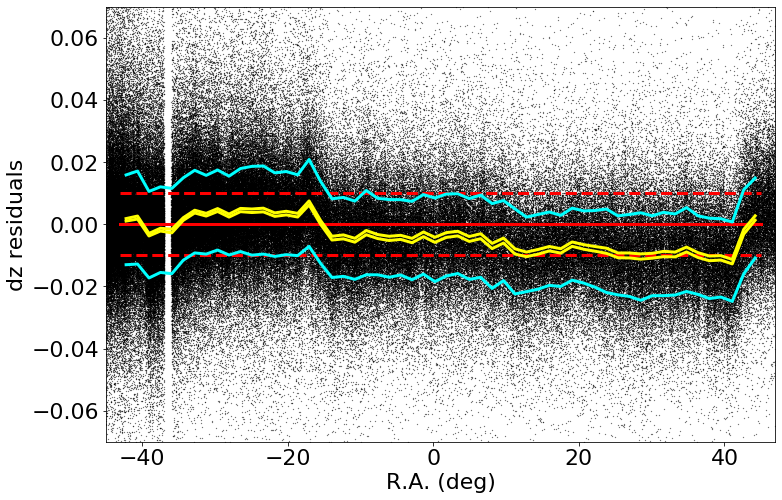

made plot colorResidPSDR2v42bright_dz_RA.png
medianAll: 2.0000000000706952e-05 std.dev.All: 0.015169752000000104
N= 509216 min= -0.2980839999999993 max= 0.2985399999999991
median: -0.004423999999999883 std.dev: 0.005144028491800935
saved plot as: colorResidPSDR2v42bright_dz_RA_Hess.png


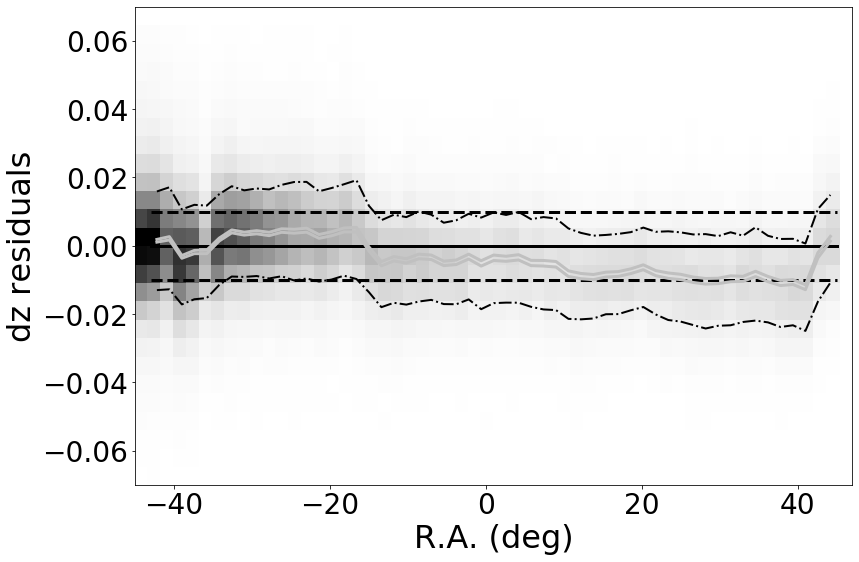

made plot colorResidPSDR2v42bright_dz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 2.0000000000706952e-05 std.dev.All: 0.015169752000000104
N= 509216 min= -0.2980839999999993 max= 0.2985399999999991
median: 0.0002642499999996814 std.dev: 0.0022887183865841305
saved plot as: colorResidPSDR2v42bright_dz_Dec.png


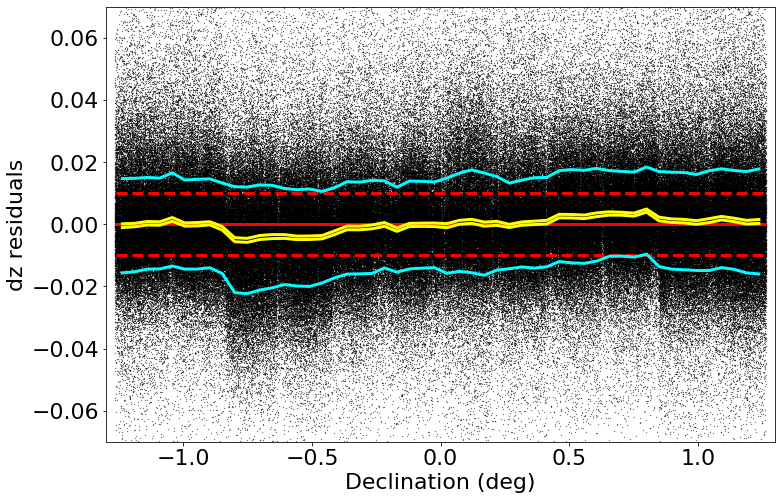

made plot colorResidPSDR2v42bright_dz_Dec.png
medianAll: 2.0000000000706952e-05 std.dev.All: 0.015169752000000104
N= 509216 min= -0.2980839999999993 max= 0.2985399999999991
median: 0.0002780000000004029 std.dev: 0.002338783457587773
saved plot as: colorResidPSDR2v42bright_dz_Dec_Hess.png


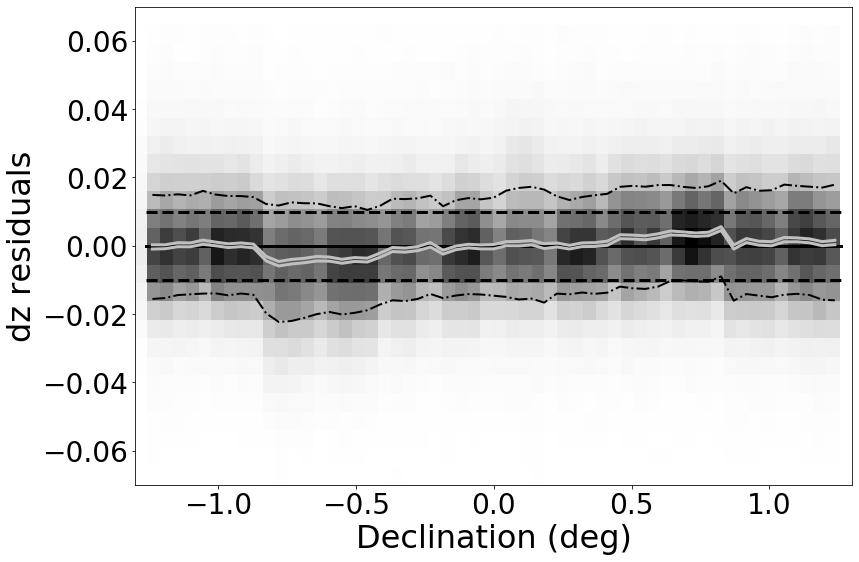

made plot colorResidPSDR2v42bright_dz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 2.0000000000706952e-05 std.dev.All: 0.015169752000000104
N= 509216 min= -0.2980839999999993 max= 0.2985399999999991
median: 7.225000000033246e-05 std.dev: 0.00115925693836531
saved plot as: colorResidPSDR2v42bright_dz_rmag.png


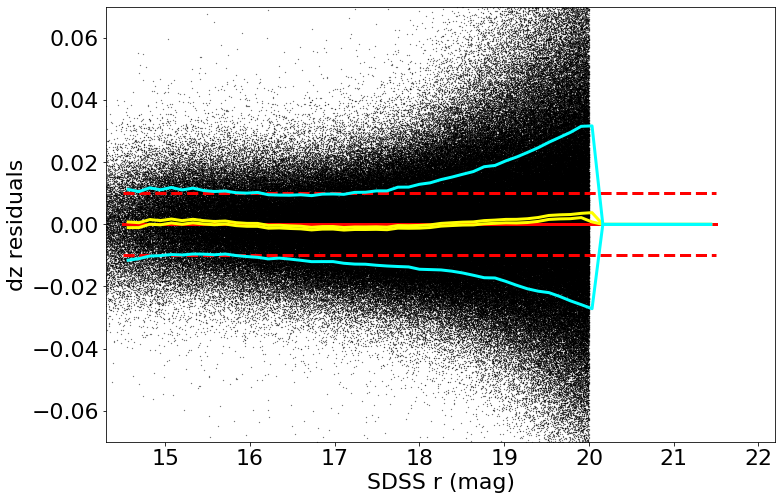

made plot colorResidPSDR2v42bright_dz_rmag.png
medianAll: 2.0000000000706952e-05 std.dev.All: 0.015169752000000104
N= 509216 min= -0.2980839999999993 max= 0.2985399999999991
median: 7.225000000033246e-05 std.dev: 0.00115925693836531
saved plot as: colorResidPSDR2v42bright_dz_rmag_Hess.png


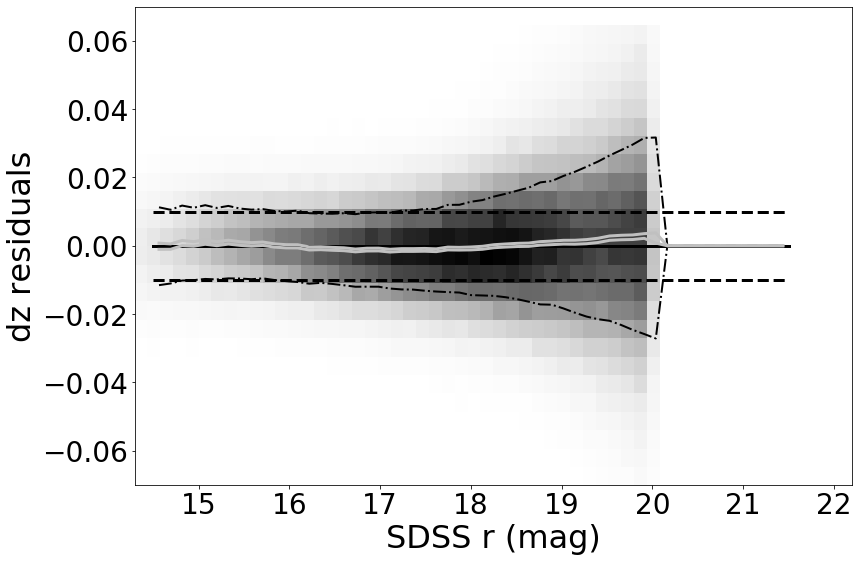

made plot colorResidPSDR2v42bright_dz_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dgr ===================
 stats for RA binning medians:
medianAll: -4.0000000002662905e-05 std.dev.All: 0.01843311600000428
N= 509549 min= -0.29804399999999964 max= 0.29930800000000035
median: -0.0012509999999987063 std.dev: 0.0029067722679593424
saved plot as: colorResidPSDR2v42bright_dgr_RA.png


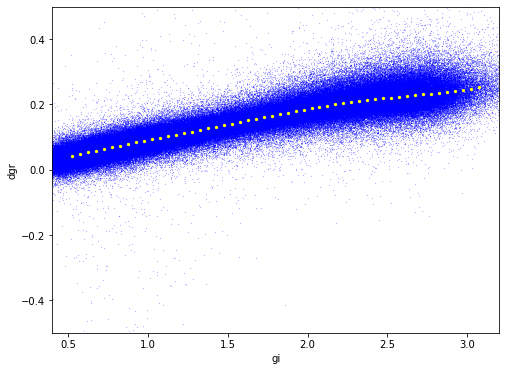

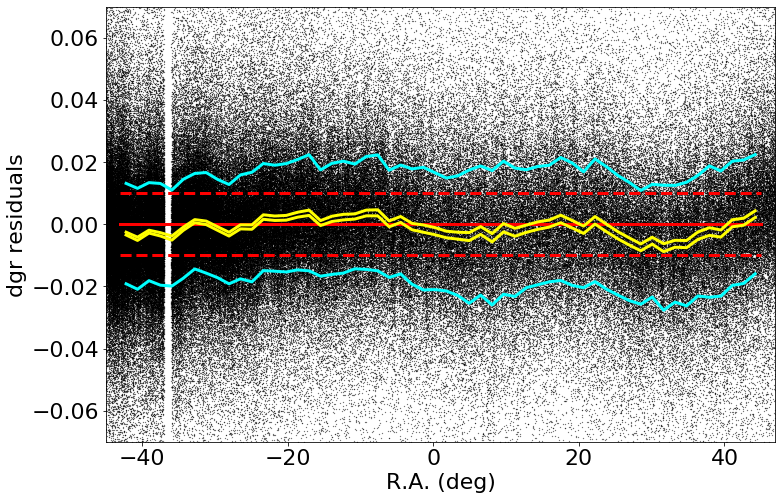

made plot colorResidPSDR2v42bright_dgr_RA.png
medianAll: -4.0000000002662905e-05 std.dev.All: 0.01843311600000428
N= 509549 min= -0.29804399999999964 max= 0.29930800000000035
median: -0.0011000000000008364 std.dev: 0.002891146548624549
saved plot as: colorResidPSDR2v42bright_dgr_RA_Hess.png


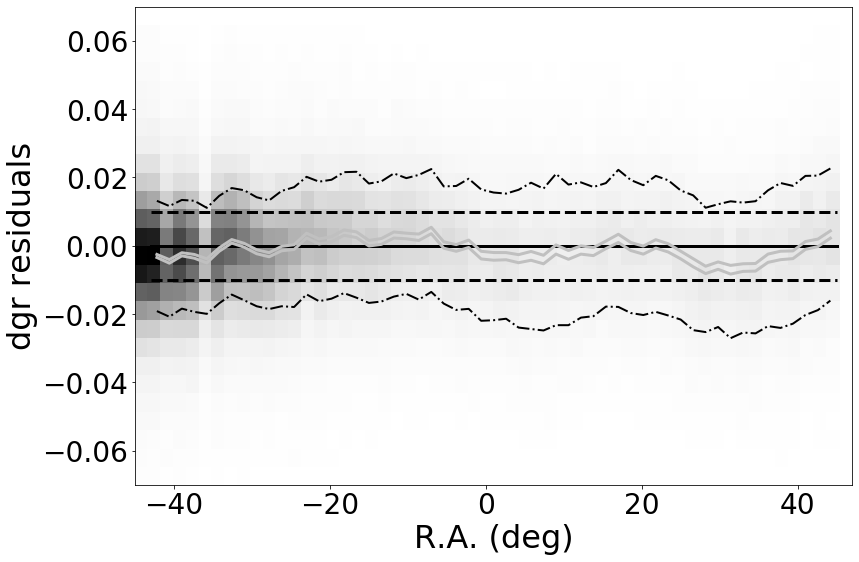

made plot colorResidPSDR2v42bright_dgr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -4.0000000002662905e-05 std.dev.All: 0.01843311600000428
N= 509549 min= -0.29804399999999964 max= 0.29930800000000035
median: 9.599999999958773e-05 std.dev: 0.0010480725229266342
saved plot as: colorResidPSDR2v42bright_dgr_Dec.png


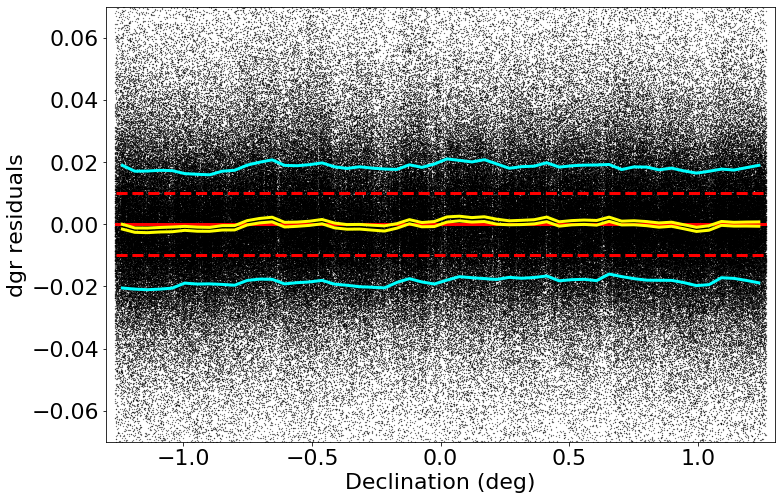

made plot colorResidPSDR2v42bright_dgr_Dec.png
medianAll: -4.0000000002662905e-05 std.dev.All: 0.01843311600000428
N= 509549 min= -0.29804399999999964 max= 0.29930800000000035
median: 0.0001000000000017931 std.dev: 0.0010798205381200227
saved plot as: colorResidPSDR2v42bright_dgr_Dec_Hess.png


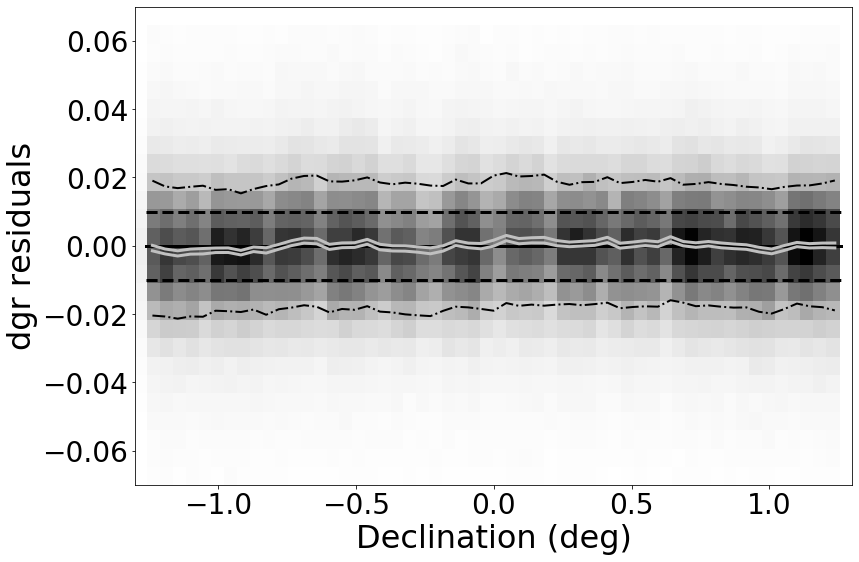

made plot colorResidPSDR2v42bright_dgr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -4.0000000002662905e-05 std.dev.All: 0.01843311600000428
N= 509549 min= -0.29804399999999964 max= 0.29930800000000035
median: 9.650000000100724e-05 std.dev: 0.001329766204478974
saved plot as: colorResidPSDR2v42bright_dgr_rmag.png


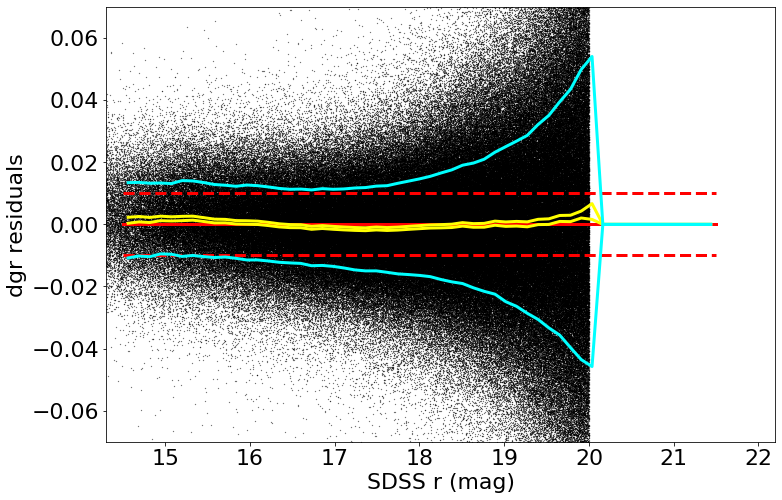

made plot colorResidPSDR2v42bright_dgr_rmag.png
medianAll: -4.0000000002662905e-05 std.dev.All: 0.01843311600000428
N= 509549 min= -0.29804399999999964 max= 0.29930800000000035
median: 9.650000000100724e-05 std.dev: 0.001329766204478974
saved plot as: colorResidPSDR2v42bright_dgr_rmag_Hess.png


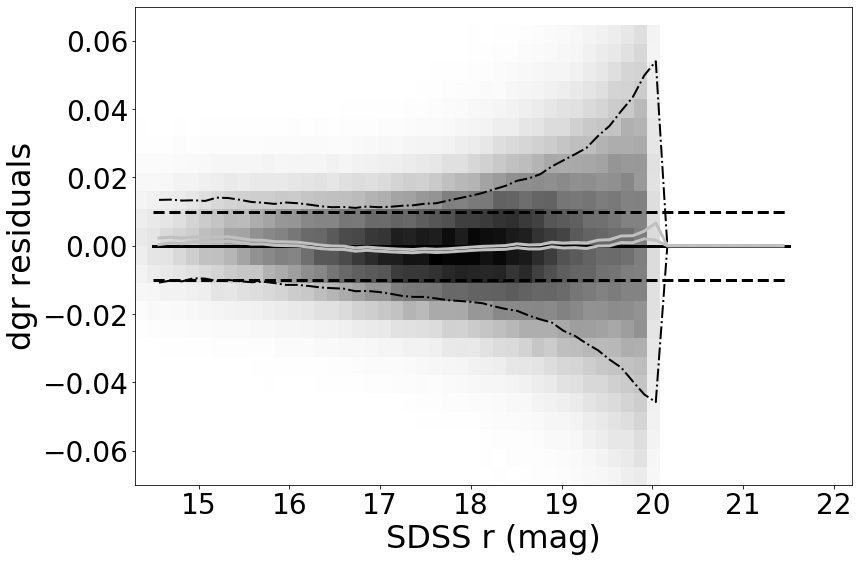

made plot colorResidPSDR2v42bright_dgr_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: dri ===================
 stats for RA binning medians:
medianAll: 0.0 std.dev.All: 0.013198691999998055
N= 509676 min= -0.2973440000000018 max= 0.2975439999999993
median: 0.0022500000000014175 std.dev: 0.00259584628664259
saved plot as: colorResidPSDR2v42bright_dri_RA.png


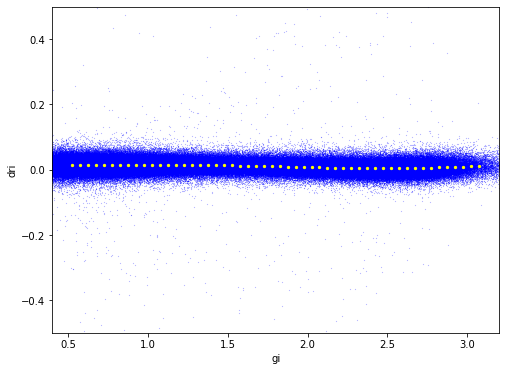

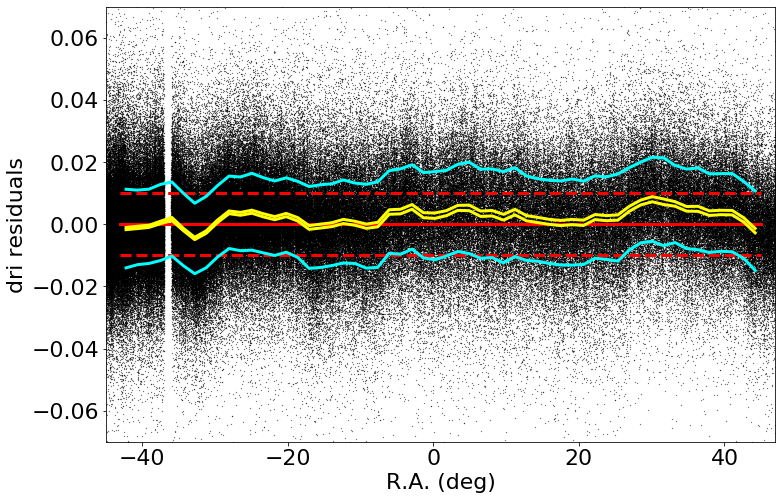

made plot colorResidPSDR2v42bright_dri_RA.png
medianAll: 0.0 std.dev.All: 0.013198691999998055
N= 509676 min= -0.2973440000000018 max= 0.2975439999999993
median: 0.002581999999997574 std.dev: 0.002612907618467581
saved plot as: colorResidPSDR2v42bright_dri_RA_Hess.png


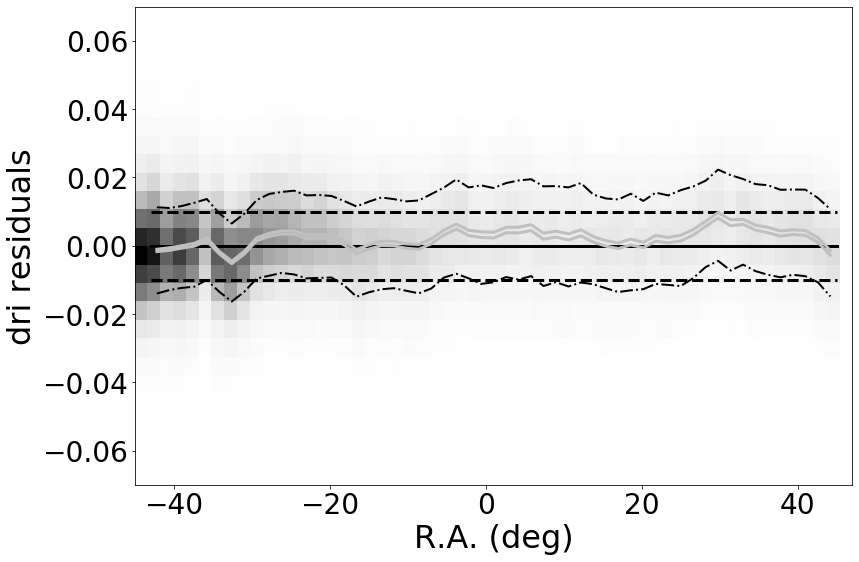

made plot colorResidPSDR2v42bright_dri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0 std.dev.All: 0.013198691999998055
N= 509676 min= -0.2973440000000018 max= 0.2975439999999993
median: 0.00020900000000215885 std.dev: 0.00098666337167485
saved plot as: colorResidPSDR2v42bright_dri_Dec.png


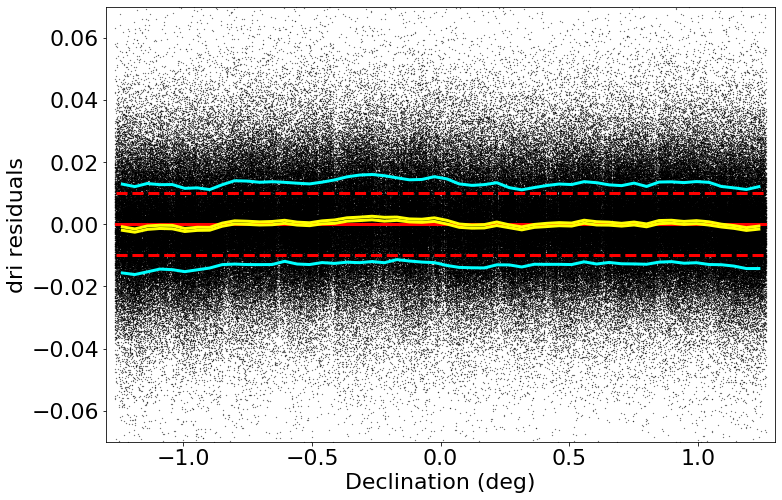

made plot colorResidPSDR2v42bright_dri_Dec.png
medianAll: 0.0 std.dev.All: 0.013198691999998055
N= 509676 min= -0.2973440000000018 max= 0.2975439999999993
median: 6.399999999774468e-05 std.dev: 0.0010419834148676333
saved plot as: colorResidPSDR2v42bright_dri_Dec_Hess.png


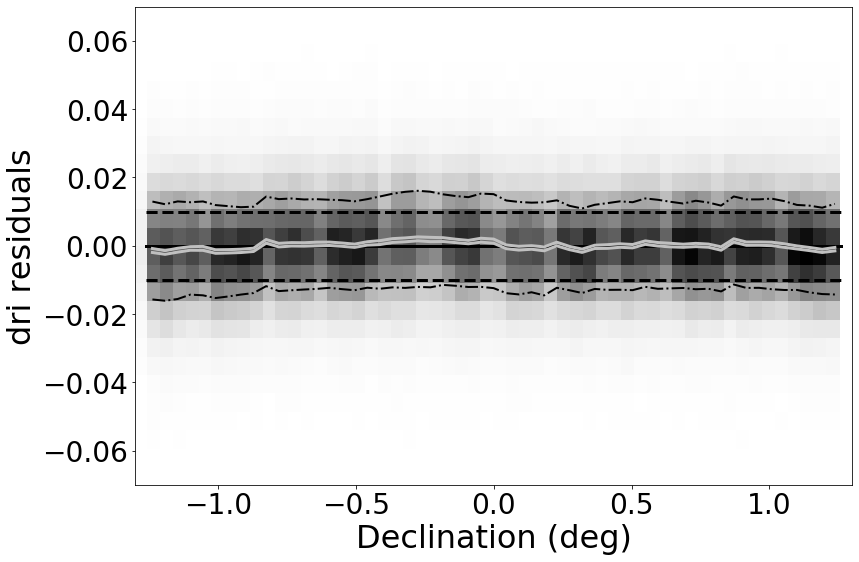

made plot colorResidPSDR2v42bright_dri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0 std.dev.All: 0.013198691999998055
N= 509676 min= -0.2973440000000018 max= 0.2975439999999993
median: -3.8499999998956036e-05 std.dev: 0.0006817633477947082
saved plot as: colorResidPSDR2v42bright_dri_rmag.png


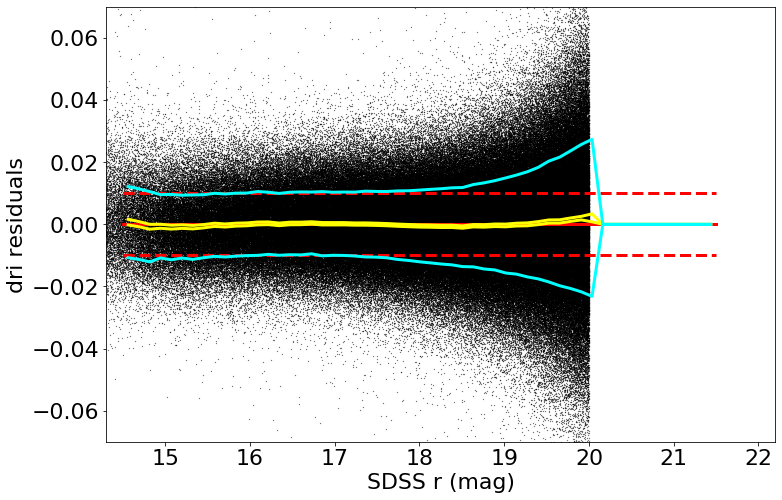

made plot colorResidPSDR2v42bright_dri_rmag.png
medianAll: 0.0 std.dev.All: 0.013198691999998055
N= 509676 min= -0.2973440000000018 max= 0.2975439999999993
median: -3.8499999998956036e-05 std.dev: 0.0006817633477947082
saved plot as: colorResidPSDR2v42bright_dri_rmag_Hess.png


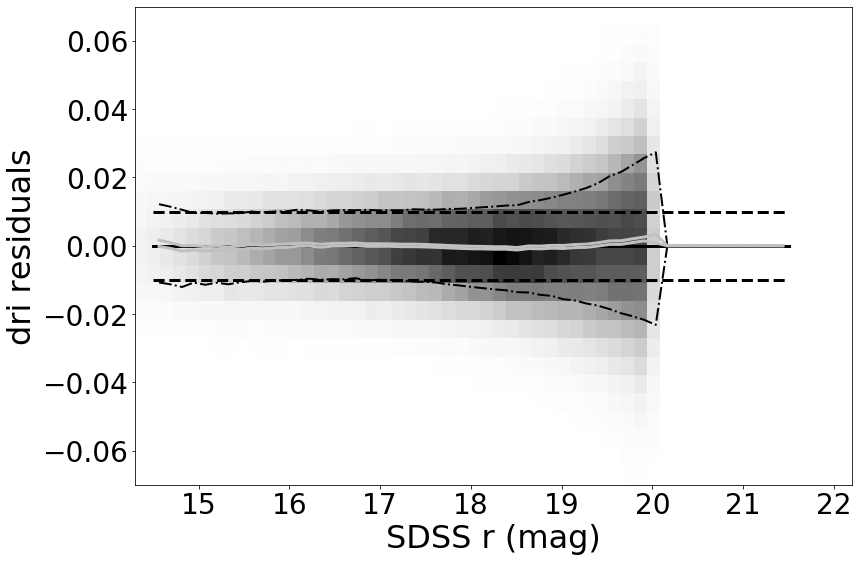

made plot colorResidPSDR2v42bright_dri_rmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: diz ===================
 stats for RA binning medians:
medianAll: -1.1999999999973837e-05 std.dev.All: 0.016331640000002205
N= 509795 min= -0.298295999999995 max= 0.2874400000000003
median: 0.0029800000000016116 std.dev: 0.004359947427013779
saved plot as: colorResidPSDR2v42bright_diz_RA.png


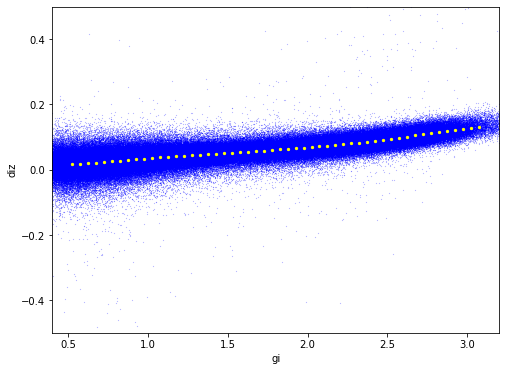

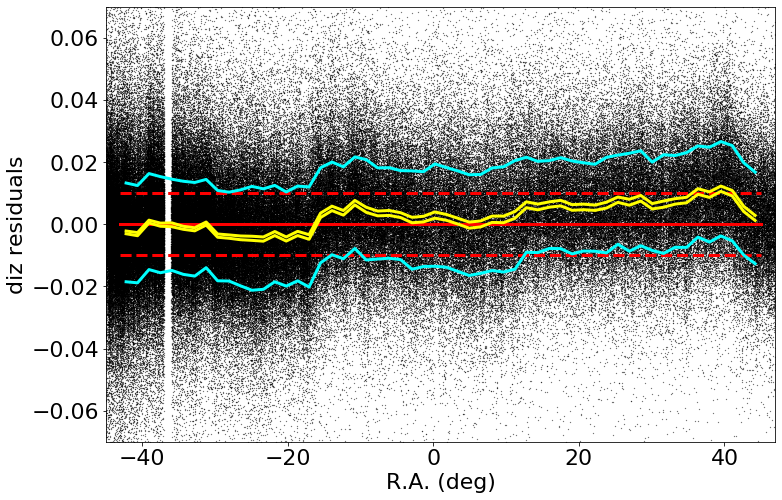

made plot colorResidPSDR2v42bright_diz_RA.png
medianAll: -1.1999999999973837e-05 std.dev.All: 0.016331640000002205
N= 509795 min= -0.298295999999995 max= 0.2874400000000003
median: 0.002990000000000541 std.dev: 0.004344810031928972
saved plot as: colorResidPSDR2v42bright_diz_RA_Hess.png


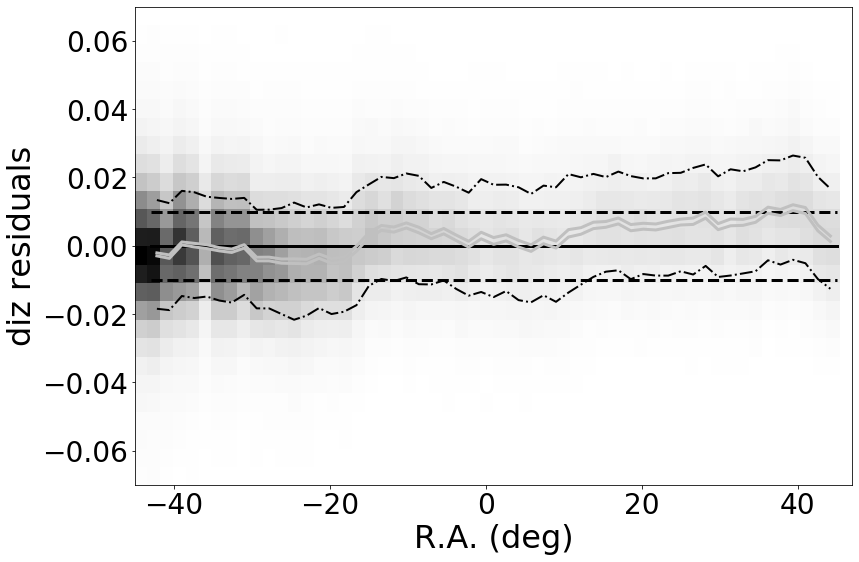

made plot colorResidPSDR2v42bright_diz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -1.1999999999973837e-05 std.dev.All: 0.016331640000002205
N= 509795 min= -0.298295999999995 max= 0.2874400000000003
median: -7.39999999990193e-05 std.dev: 0.0017265455185179242
saved plot as: colorResidPSDR2v42bright_diz_Dec.png


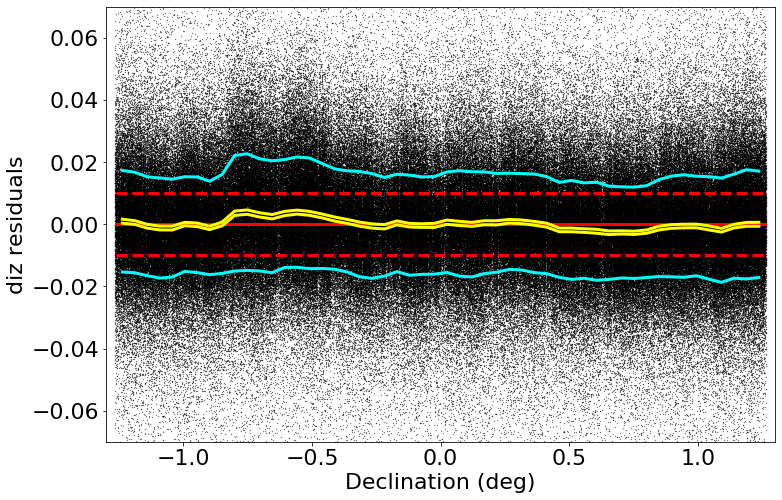

made plot colorResidPSDR2v42bright_diz_Dec.png
medianAll: -1.1999999999973837e-05 std.dev.All: 0.016331640000002205
N= 509795 min= -0.298295999999995 max= 0.2874400000000003
median: -0.00021100000000133165 std.dev: 0.0017394576840816642
saved plot as: colorResidPSDR2v42bright_diz_Dec_Hess.png


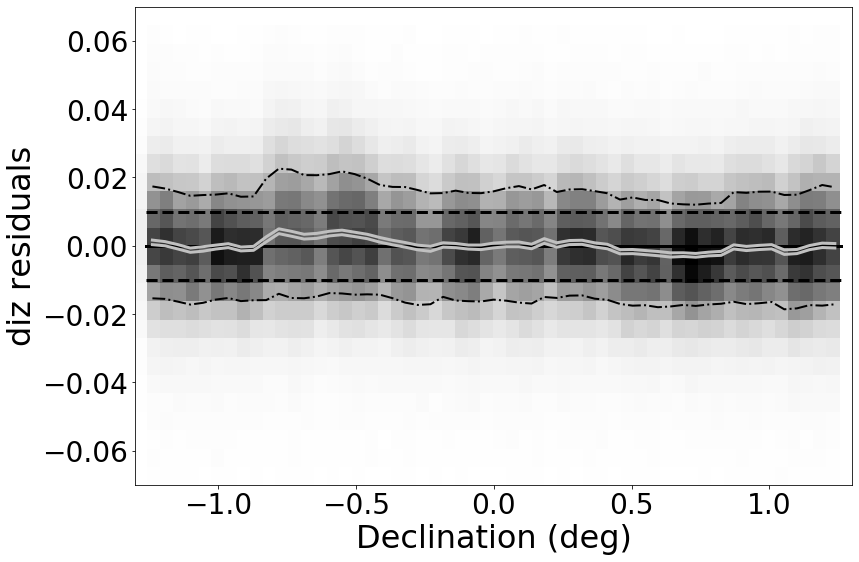

made plot colorResidPSDR2v42bright_diz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -1.1999999999973837e-05 std.dev.All: 0.016331640000002205
N= 509795 min= -0.298295999999995 max= 0.2874400000000003
median: 0.0007810000000027482 std.dev: 0.0027979655415123084
saved plot as: colorResidPSDR2v42bright_diz_rmag.png


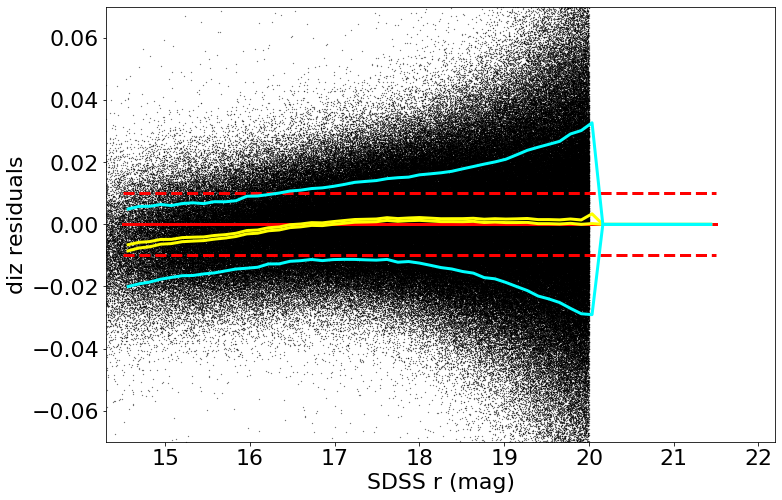

made plot colorResidPSDR2v42bright_diz_rmag.png
medianAll: -1.1999999999973837e-05 std.dev.All: 0.016331640000002205
N= 509795 min= -0.298295999999995 max= 0.2874400000000003
median: 0.0007810000000027482 std.dev: 0.0027979655415123084
saved plot as: colorResidPSDR2v42bright_diz_rmag_Hess.png


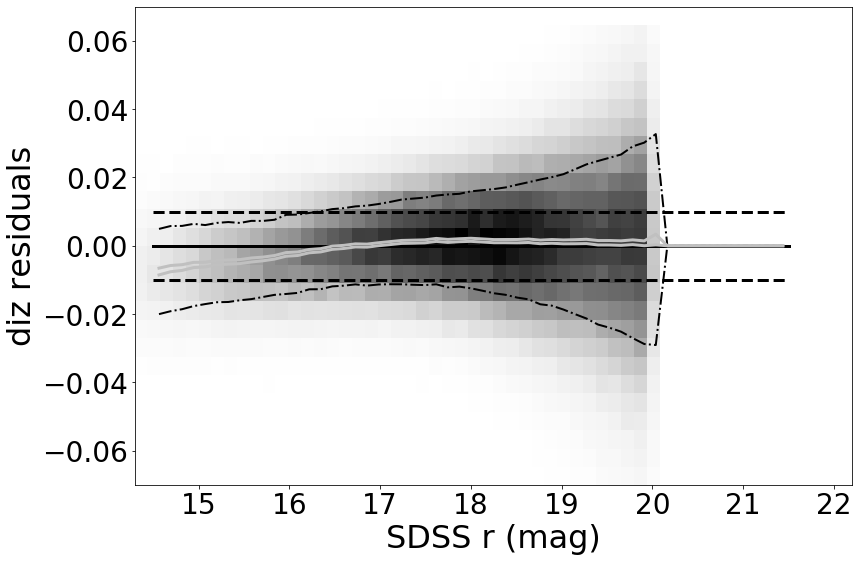

made plot colorResidPSDR2v42bright_diz_rmag_Hess.png
------------------------------------------------------------------


In [15]:
keywords = {"Xstr":'gi', "plotNameRoot":'colorResidPSDR2v42bright_', "symbSize":0.05}
for color in ('dg', 'dr', 'di', 'dz', 'dgr', 'dri', 'diz'):
    keywords["Ystr"] = color 
    doOneColor(sdssPSbright, keywords)